In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import math

In [2]:
tr_tr = pd.read_csv('./data/train_transaction.csv')
te_tr = pd.read_csv('./data/test_transaction.csv')
tr_id = pd.read_csv('./data/train_identity.csv')
te_id = pd.read_csv('./data/test_identity.csv')

In [3]:
tr_tr.head()

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,...,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339
0,2987000,0,86400,68.5,W,13926,NaN,150.0,discover,142.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2987001,0,86401,29.0,W,2755,404.0,150.0,mastercard,102.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2987002,0,86469,59.0,W,4663,490.0,150.0,visa,166.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2987003,0,86499,50.0,W,18132,567.0,150.0,mastercard,117.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2987004,0,86506,50.0,H,4497,514.0,150.0,mastercard,102.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [4]:
te_tr.head()

,TransactionID,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,...,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339
0,3663549,18403224,31.95,W,10409,111.0,150.0,visa,226.0,debit,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,3663550,18403263,49.00,W,4272,111.0,150.0,visa,226.0,debit,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,3663551,18403310,171.00,W,4476,574.0,150.0,visa,226.0,debit,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3663552,18403310,284.95,W,10989,360.0,150.0,visa,166.0,debit,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,3663553,18403317,67.95,W,18018,452.0,150.0,mastercard,117.0,debit,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [5]:
tr_id.head()

,TransactionID,id_01,id_02,id_03,id_04,id_05,id_06,id_07,id_08,id_09,...,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo
0,2987004,0.0,70787.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,samsung browser 6.2,32.0,2220x1080,match_status:2,T,F,T,T,mobile,SAMSUNG SM-G892A Build/NRD90M
1,2987008,-5.0,98945.0,NaN,NaN,0.0,-5.0,NaN,NaN,NaN,...,mobile safari 11.0,32.0,1334x750,match_status:1,T,F,F,T,mobile,iOS Device
2,2987010,-5.0,191631.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,...,chrome 62.0,NaN,NaN,NaN,F,F,T,T,desktop,Windows
3,2987011,-5.0,221832.0,NaN,NaN,0.0,-6.0,NaN,NaN,NaN,...,chrome 62.0,NaN,NaN,NaN,F,F,T,T,desktop,NaN
4,2987016,0.0,7460.0,0.0,0.0,1.0,0.0,NaN,NaN,0.0,...,chrome 62.0,24.0,1280x800,match_status:2,T,F,T,T,desktop,MacOS


In [6]:
te_id.head()

,TransactionID,id-01,id-02,id-03,id-04,id-05,id-06,id-07,id-08,id-09,...,id-31,id-32,id-33,id-34,id-35,id-36,id-37,id-38,DeviceType,DeviceInfo
0,3663586,-45.0,280290.0,NaN,NaN,0.0,0.0,NaN,NaN,NaN,...,chrome 67.0 for android,NaN,NaN,NaN,F,F,T,F,mobile,MYA-L13 Build/HUAWEIMYA-L13
1,3663588,0.0,3579.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,...,chrome 67.0 for android,24.0,1280x720,match_status:2,T,F,T,T,mobile,LGLS676 Build/MXB48T
2,3663597,-5.0,185210.0,NaN,NaN,1.0,0.0,NaN,NaN,NaN,...,ie 11.0 for tablet,NaN,NaN,NaN,F,T,T,F,desktop,Trident/7.0
3,3663601,-45.0,252944.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,...,chrome 67.0 for android,NaN,NaN,NaN,F,F,T,F,mobile,MYA-L13 Build/HUAWEIMYA-L13
4,3663602,-95.0,328680.0,NaN,NaN,7.0,-33.0,NaN,NaN,NaN,...,chrome 67.0 for android,NaN,NaN,NaN,F,F,T,F,mobile,SM-G9650 Build/R16NW


In [7]:
import plotly.graph_objects as go

# Prepare histogram data for train and test sets
train_hist_data = go.Histogram(
    x=tr_tr['TransactionDT'],
    opacity=0.5,
    name='train',
    marker=dict(color='grey')
)

test_hist_data = go.Histogram(
    x=te_tr['TransactionDT'],
    opacity=0.5,
    name='test',
    marker=dict(color='blue')
)

# Create the layout
layout = go.Layout(
    barmode='overlay',  # Overlapping bars
    title="TransactionDT Histogram",
    xaxis_title="TransactionDT",
    yaxis_title="Count",
    width=1400,  # Width of the plot
    height=600   # Height of the plot
)

# Add data to the figure and display
fig = go.Figure(data=[train_hist_data, test_hist_data], layout=layout)
fig.show()


In [8]:
v_columns = [col for col in tr_tr.columns if col.startswith('V')]

In [9]:
all_columns = set(tr_tr.columns)
columns_without_v = list(all_columns - set(v_columns))

In [10]:
tr_tr_without_v = tr_tr[columns_without_v]

In [11]:
tr_tr_without_v

,D4,C13,C14,addr2,M5,D13,D10,ProductCD,card4,D11,...,D12,card1,D6,isFraud,TransactionDT,C10,C4,C1,M1,M9
0,NaN,1.0,1.0,87.0,F,NaN,13.0,W,discover,13.0,...,NaN,13926,NaN,0,86400,0.0,0.0,1.0,T,NaN
1,0.0,1.0,1.0,87.0,T,NaN,0.0,W,mastercard,NaN,...,NaN,2755,NaN,0,86401,0.0,0.0,1.0,NaN,NaN
2,0.0,1.0,1.0,87.0,F,NaN,0.0,W,visa,315.0,...,NaN,4663,NaN,0,86469,0.0,0.0,1.0,T,F
3,94.0,25.0,1.0,87.0,T,NaN,84.0,W,mastercard,NaN,...,NaN,18132,NaN,0,86499,0.0,0.0,2.0,NaN,NaN
4,NaN,1.0,1.0,87.0,NaN,NaN,NaN,H,mastercard,NaN,...,NaN,4497,NaN,0,86506,1.0,0.0,1.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
590535,NaN,3.0,2.0,87.0,T,NaN,56.0,W,visa,56.0,...,NaN,6550,NaN,0,15811047,0.0,0.0,2.0,T,T
590536,0.0,1.0,1.0,87.0,F,NaN,0.0,W,mastercard,0.0,...,NaN,10444,NaN,0,15811049,0.0,0.0,1.0,T,F
590537,0.0,1.0,1.0,87.0,NaN,NaN,0.0,W,mastercard,0.0,...,NaN,12037,NaN,0,15811079,0.0,0.0,1.0,T,NaN
590538,22.0,5.0,1.0,87.0,F,NaN,22.0,W,mastercard,22.0,...,NaN,7826,NaN,0,15811088,0.0,0.0,1.0,T,NaN


In [12]:
tr_tr_v = tr_tr[v_columns]

In [13]:
# Calculate the number of NaN values for each column
nan_counts = tr_tr.isna().sum()

# Convert the Series to a DataFrame
nan_df = nan_counts.reset_index()

# Rename the columns
nan_df.columns = ['Column Name', 'Number of NaN']

nan_df

,Column Name,Number of NaN
0,TransactionID,0
1,isFraud,0
2,TransactionDT,0
3,TransactionAmt,0
4,ProductCD,0
...,...,...
389,V335,508189
390,V336,508189
391,V337,508189
392,V338,508189


In [14]:
# 3. Group columns by their NaN counts and convert to the desired dictionary format
nan_grouping = {}
for column, count in nan_counts.items():
    if count in nan_grouping:
        nan_grouping[count].append(column)
    else:
        nan_grouping[count] = [column]

# Result
nan_grouping

{0: ['TransactionID',
  'isFraud',
  'TransactionDT',
  'TransactionAmt',
  'ProductCD',
  'card1',
  'C1',
  'C2',
  'C3',
  'C4',
  'C5',
  'C6',
  'C7',
  'C8',
  'C9',
  'C10',
  'C11',
  'C12',
  'C13',
  'C14'],
 8933: ['card2'],
 1565: ['card3'],
 1577: ['card4'],
 4259: ['card5'],
 1571: ['card6'],
 65706: ['addr1', 'addr2'],
 352271: ['dist1'],
 552913: ['dist2'],
 94456: ['P_emaildomain'],
 453249: ['R_emaildomain'],
 1269: ['D1',
  'V281',
  'V282',
  'V283',
  'V288',
  'V289',
  'V296',
  'V300',
  'V301',
  'V313',
  'V314',
  'V315'],
 280797: ['D2'],
 262878: ['D3'],
 168922: ['D4'],
 309841: ['D5'],
 517353: ['D6'],
 551623: ['D7'],
 515614: ['D8', 'D9'],
 76022: ['D10'],
 279287: ['D11',
  'V1',
  'V2',
  'V3',
  'V4',
  'V5',
  'V6',
  'V7',
  'V8',
  'V9',
  'V10',
  'V11'],
 525823: ['D12'],
 528588: ['D13'],
 528353: ['D14'],
 89113: ['D15'],
 271100: ['M1', 'M2', 'M3'],
 281444: ['M4'],
 350482: ['M5'],
 169360: ['M6'],
 346265: ['M7'],
 346252: ['M8', 'M9'],
 76

In [15]:
variables_final = columns_without_v.copy()

In [16]:
def concatenate_with_prefix(vf, numbers):
    # Convert numbers to the desired format and concatenate
    vf.extend(['V'+str(n) for n in numbers])
    return vf

# Missing values = 65706.
## addr1 and addr2

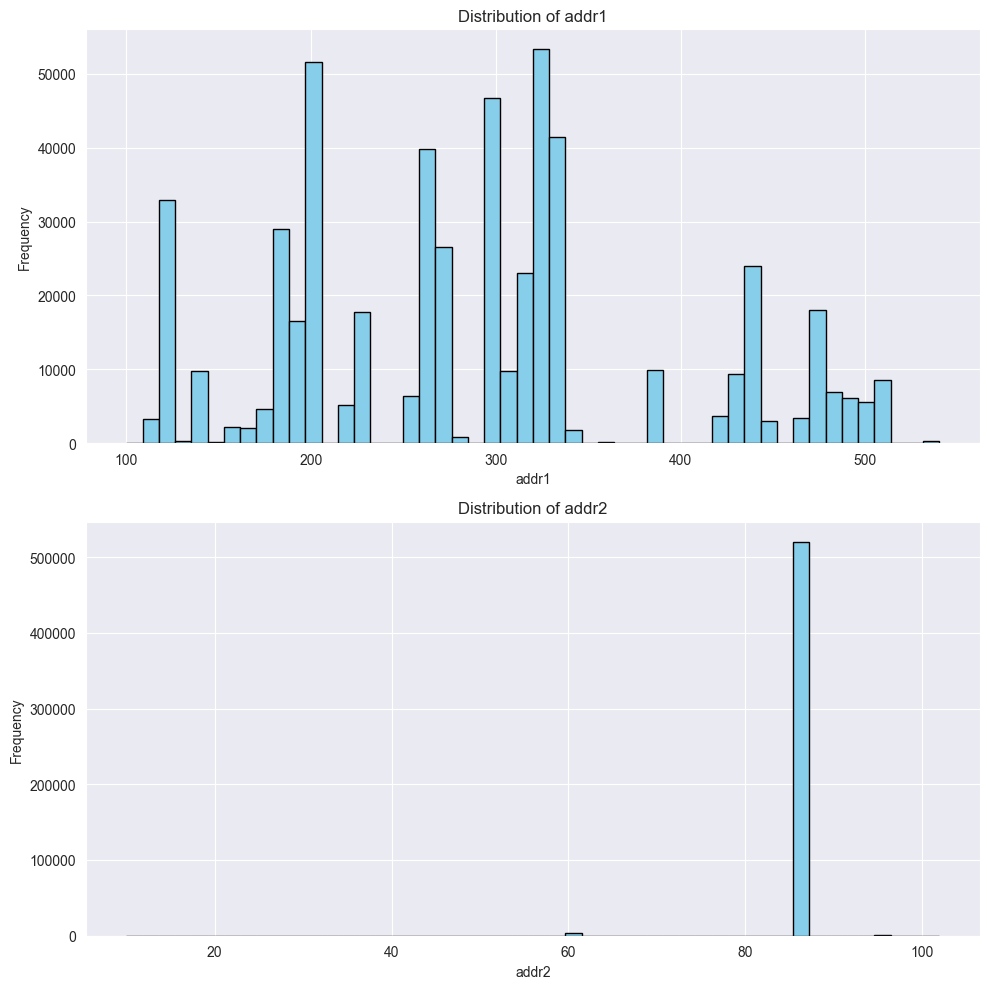

In [17]:
import matplotlib.pyplot as plt

# Number of columns in the grouping
num_columns = len(nan_grouping[65706])

# Set up the subplots
fig, axes = plt.subplots(nrows=num_columns, figsize=(10, 5*num_columns))

# For each column, plot the histogram of non-NaN values
for ax, col in zip(axes, nan_grouping[65706]):
    tr_tr[col].dropna().plot(kind='hist', ax=ax, bins=50, color='skyblue', edgecolor='black')
    ax.set_title(f'Distribution of {col}')
    ax.set_xlabel(col)
    ax.set_ylabel('Frequency')

plt.tight_layout()
plt.show()


In [18]:
def plot_histograms_grid(key, data, grouping):
    """
    Plot histograms for the columns present in the provided key of the grouping in a grid format.

    Args:
    - key (int): The key for nan_grouping to fetch columns.
    - data (DataFrame): The DataFrame containing the data.
    - grouping (dict): The dictionary grouping columns by number of NaN values.
    """

    # Number of columns in the grouping
    columns_to_plot = grouping[key]
    num_columns = len(columns_to_plot)

    # Calculate number of rows based on a maximum of 5 columns per row
    num_rows = math.ceil(num_columns / 5)
    
    fig, axes = plt.subplots(nrows=num_rows, ncols=5, figsize=(22, 4*num_rows))
    
    # If there's only one row, ensure that axes is a 2D array for consistent indexing
    if num_rows == 1:
        axes = [axes]

    # For each column, plot the histogram of non-NaN values
    for idx, col in enumerate(columns_to_plot):
        ax = axes[idx//5][idx%5]
        data[col].dropna().plot(kind='hist', ax=ax, bins=50, color='skyblue', edgecolor='black')
        ax.set_title(f'Distribution of {col}')
        ax.set_xlabel(col)
        ax.set_ylabel('Frequency')

    # If the last row isn't full, remove unused subplots
    if num_columns % 5 != 0:
        for idx in range(num_columns % 5, 5):
            fig.delaxes(axes[num_rows - 1][idx])

    plt.tight_layout()
    plt.show()

# Usage
# plot_histograms_grid(65706, tr_tr, nan_grouping)


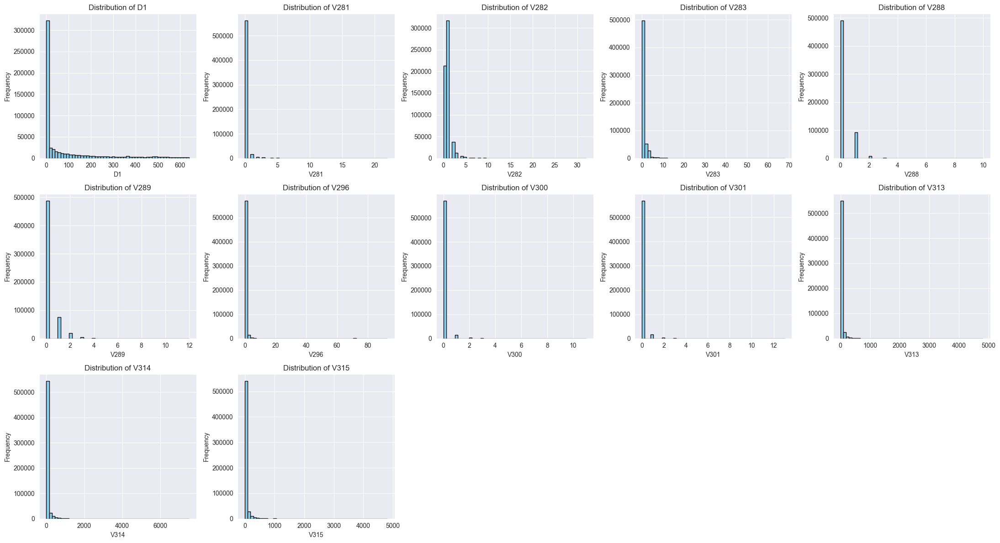

In [19]:
plot_histograms_grid(1269, tr_tr, nan_grouping)

In [20]:
def plot_heatmap(key, data, grouping, w, h, split_frac=None, frac_ret=None):
    """
    Plot a heatmap showing the correlations between the columns present in the provided key of the grouping and 'TransactionDT'.

    Args:
    - key (int): The key for nan_grouping to fetch columns.
    - data (DataFrame): The DataFrame containing the data.
    - grouping (dict): The dictionary grouping columns by number of NaN values.
    - split_frac (int, optional): Number of splits. If 2, it splits 50/50. If 3, it splits 33/33/33. Defaults to None.
    - frac_ret (int, optional): The fraction to return after splitting. 1 returns the first fraction, 2 the second, etc. Defaults to None.
    """

    columns_of_interest = ['TransactionDT'] + grouping[key]

    # Check if split_frac and frac_ret are provided and valid
    if split_frac and frac_ret:
        if frac_ret > split_frac or frac_ret < 1:
            raise ValueError("Invalid value for frac_ret based on split_frac.")
    
        n = len(grouping[key])
        segment_size = n // split_frac
        start_idx = segment_size * (frac_ret - 1)
        # Adjust the end index for the last segment
        end_idx = start_idx + segment_size if frac_ret != split_frac else len(grouping[key])
        columns_of_interest = ['TransactionDT'] + grouping[key][start_idx:end_idx]

    subdata = data[columns_of_interest].dropna()

    # Calculate correlation matrix
    corr_matrix = subdata.corr()
    
    # Set up the matplotlib figure
    plt.figure(figsize=(w, h))
    
    # Generate a custom diverging colormap
    cmap = sns.diverging_palette(220, 10, as_cmap=True)
    
    # Draw the heatmap
    sns.heatmap(corr_matrix, cmap=cmap, vmax=1, center=0,
                square=True, linewidths=.5, cbar_kws={"shrink": 0.75}, annot=True)
    
    plt.title('Correlation heatmap of selected variables and TransactionDT')
    plt.show()


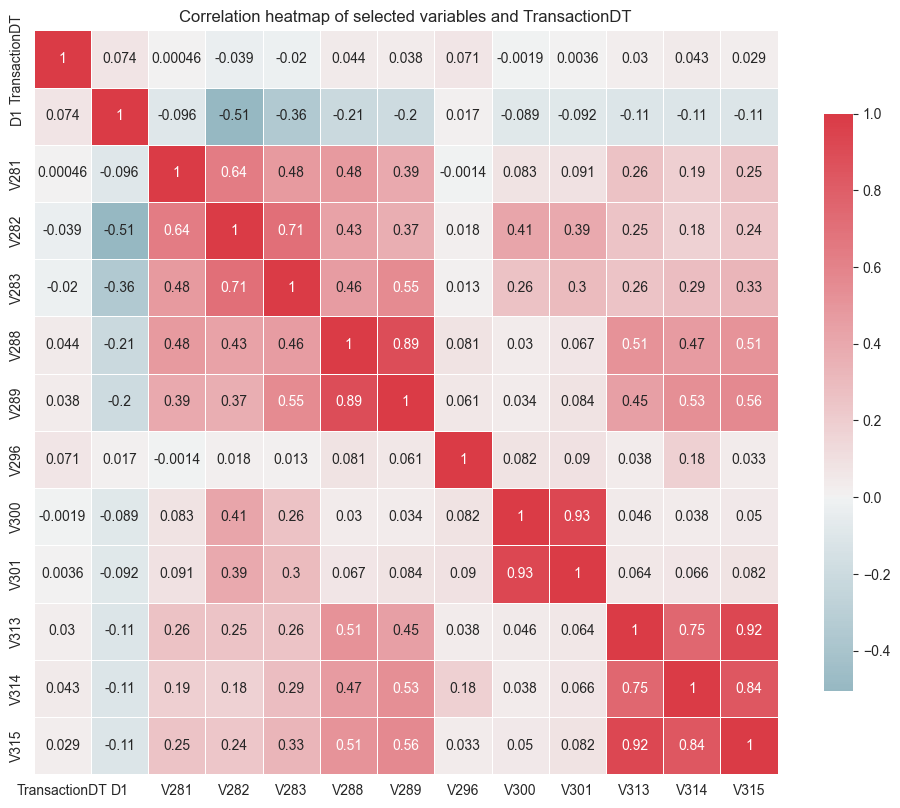

In [21]:
plot_heatmap(1269, tr_tr, nan_grouping, 12, 10)

Distinct Groups:

    V281: This variable doesn't show strong correlation with others, hence it stands alone.
    V282, V283: These variables are highly correlated with each other but not as strongly with the other variables.
    V288, V289: Similarly, these two variables are closely related to each other.
    V296: Like V281, this variable is independent of others.
    V300, V301: These two show strong correlation, so they're grouped together.
    V313, V314, V315: These three variables have high correlation amongst themselves.

In [22]:
def reduce_group_report(grps, c='V'):
    use = []
    report = []

    for g in grps:
        variable_data = [(tr_tr[c+str(gg)].nunique(), gg) for gg in g]
        chosen_variable = max(variable_data, key=lambda x: x[0])[1]
        use.append(chosen_variable)
        
        # Generate the report for this group
        report_details = []
        for (n, gg) in variable_data:
            status = "chosen" if gg == chosen_variable else "not chosen"
            report_details.append(f"{c}{gg} with {n} unique values was {status}.")
        report.append("\n".join(report_details))

    # Combine all group reports
    report_output = "\n\n".join(report)

    return use, report_output

In [23]:
# Use the function
selected_vars, detailed_report = reduce_group_report([[281],[282,283],[288,289],[296],[300,301],[313,314,315]])
concatenate_with_prefix(variables_final, selected_vars)
print('Use these:', selected_vars)
print('\nReport:\n', detailed_report)

Use these: [281, 283, 289, 296, 301, 314]

Report:
 V281 with 23 unique values was chosen.

V282 with 33 unique values was not chosen.
V283 with 62 unique values was chosen.

V288 with 11 unique values was not chosen.
V289 with 13 unique values was chosen.

V296 with 94 unique values was chosen.

V300 with 12 unique values was not chosen.
V301 with 14 unique values was chosen.

V313 with 5529 unique values was not chosen.
V314 with 11377 unique values was chosen.
V315 with 6973 unique values was not chosen.


# Missing values = 515614.
## D8 and D9

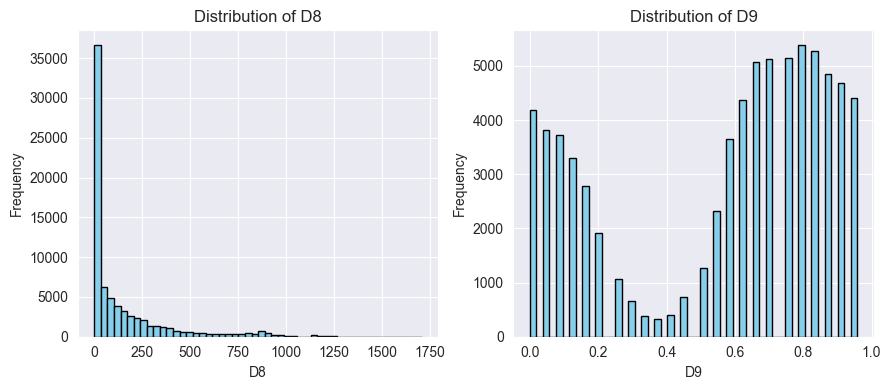

In [24]:
plot_histograms_grid(515614, tr_tr, nan_grouping)

# Missing values = 279287.
## D11 and V1-V11

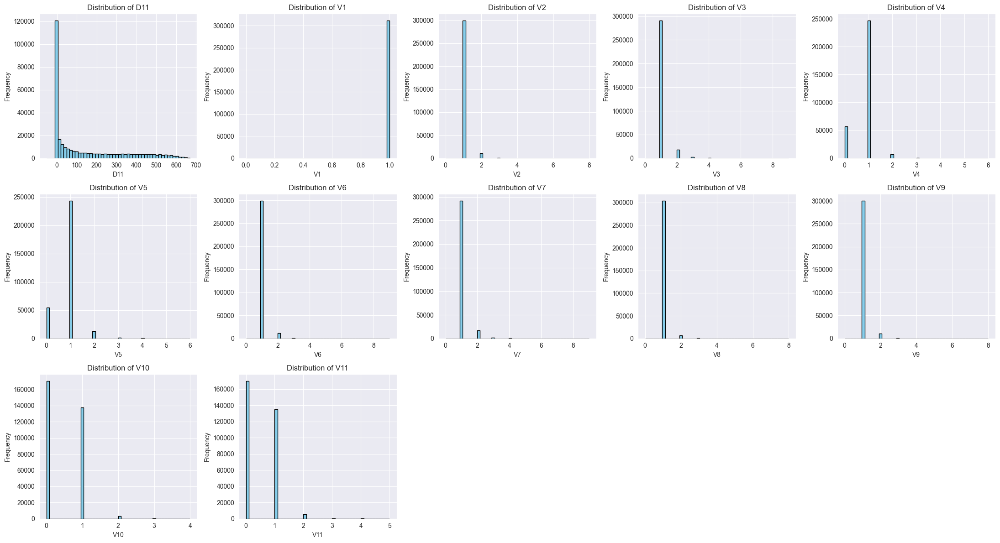

In [25]:
plot_histograms_grid(279287, tr_tr, nan_grouping)

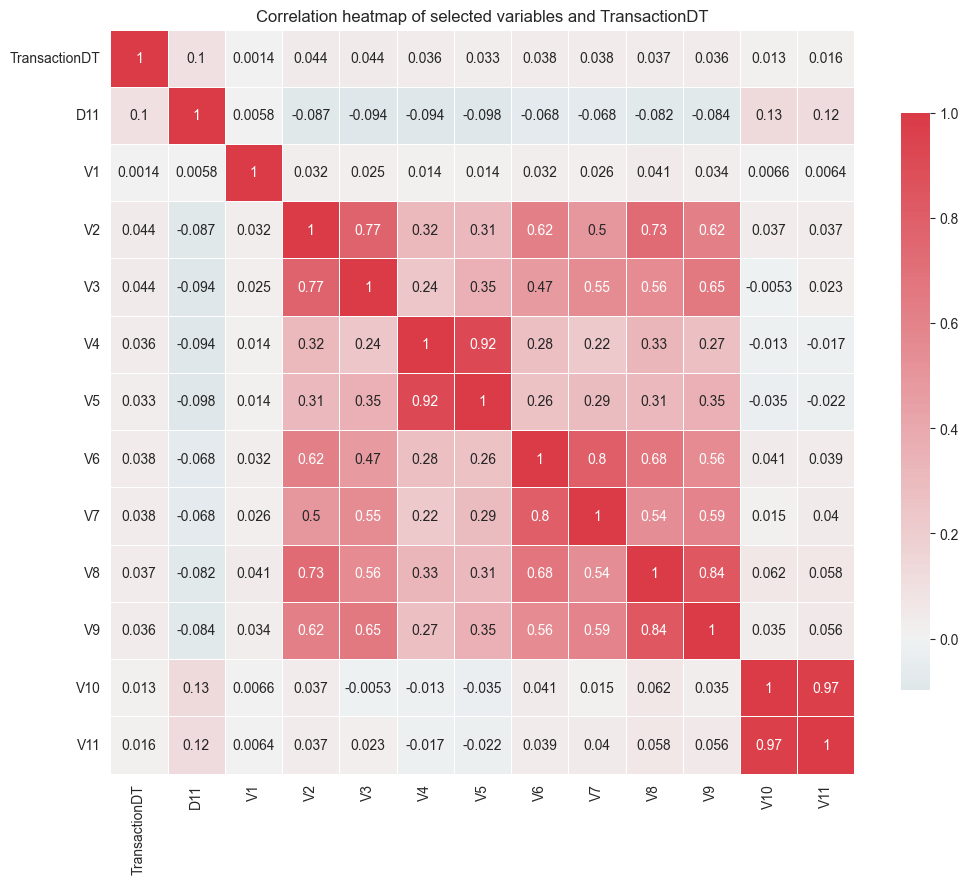

In [26]:
plot_heatmap(279287, tr_tr, nan_grouping, 12, 10)

V1: This variable doesn't show strong correlation with others, hence it stands alone.
V2, V3: These variables are highly correlated with each other but not as strongly with the other variables.
V4, V5: Similarly, these two variables are closely related to each other.
V6, V7: These two show strong correlation, so they're grouped together.
V8, V9: These variables have high correlation amongst themselves.
V10, V11: These two variables are closely correlated with each other but don't show as strong correlation with the other variables.

In [27]:
selected_vars, detailed_report = reduce_group_report([[1],[2,3],[4,5],[6,7],[8,9],[10,11]])
print('Use these:', selected_vars)
print('\nReport:\n', detailed_report)
concatenate_with_prefix(variables_final, selected_vars)

Use these: [1, 3, 4, 6, 8, 11]

Report:
 V1 with 2 unique values was chosen.

V2 with 9 unique values was not chosen.
V3 with 10 unique values was chosen.

V4 with 7 unique values was chosen.
V5 with 7 unique values was not chosen.

V6 with 10 unique values was chosen.
V7 with 10 unique values was not chosen.

V8 with 9 unique values was chosen.
V9 with 9 unique values was not chosen.

V10 with 5 unique values was not chosen.
V11 with 6 unique values was chosen.


['D4',
 'C13',
 'C14',
 'addr2',
 'M5',
 'D13',
 'D10',
 'ProductCD',
 'card4',
 'D11',
 'C12',
 'M4',
 'M2',
 'P_emaildomain',
 'card5',
 'addr1',
 'D8',
 'D2',
 'D3',
 'M8',
 'M7',
 'D15',
 'D7',
 'C8',
 'M3',
 'D1',
 'dist1',
 'C3',
 'C2',
 'D9',
 'C6',
 'R_emaildomain',
 'card2',
 'C11',
 'TransactionID',
 'TransactionAmt',
 'dist2',
 'C9',
 'D5',
 'M6',
 'card6',
 'C7',
 'C5',
 'D14',
 'card3',
 'D12',
 'card1',
 'D6',
 'isFraud',
 'TransactionDT',
 'C10',
 'C4',
 'C1',
 'M1',
 'M9',
 'V281',
 'V283',
 'V289',
 'V296',
 'V301',
 'V314',
 'V1',
 'V3',
 'V4',
 'V6',
 'V8',
 'V11']

# Missing values = 76073.
## V12 - V34

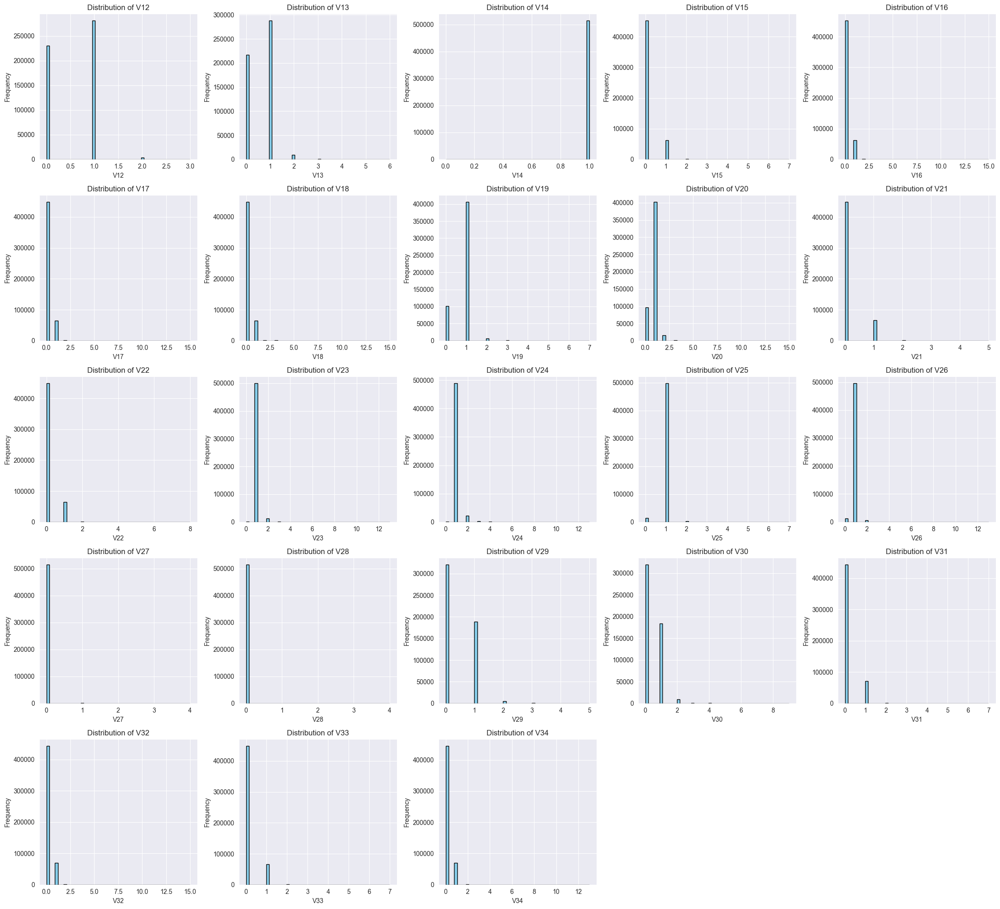

In [28]:
plot_histograms_grid(76073, tr_tr, nan_grouping)

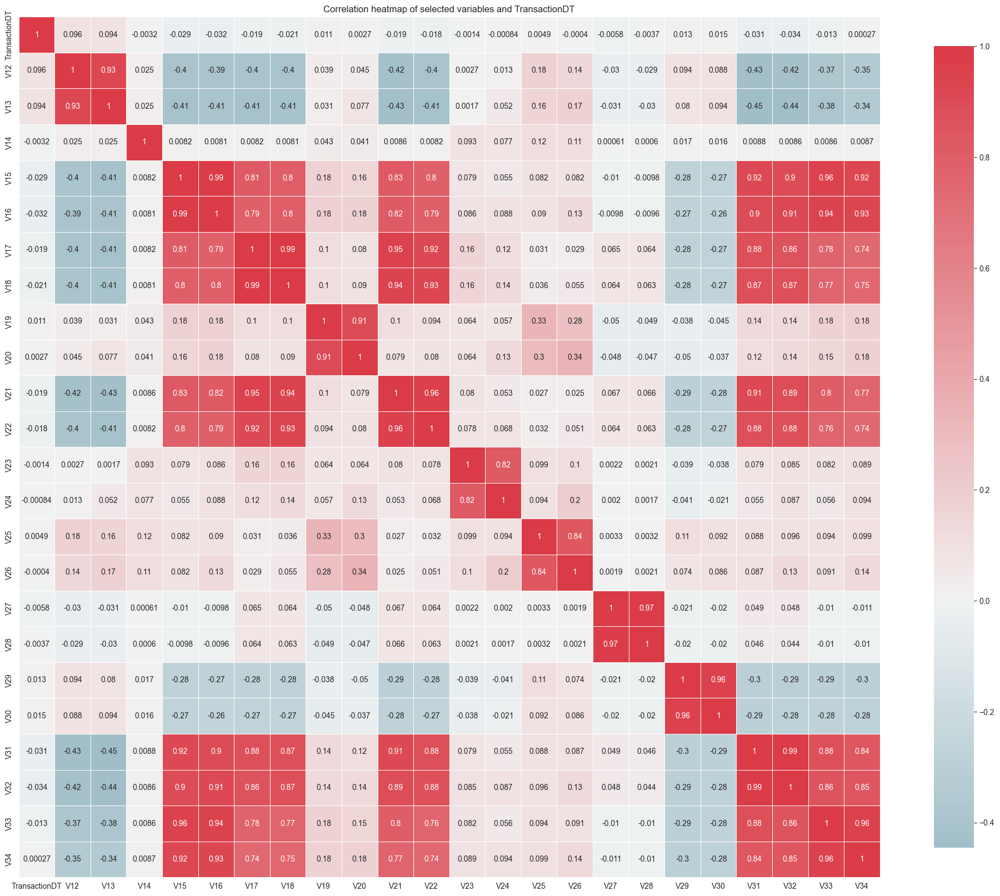

In [29]:
plot_heatmap(76073, tr_tr, nan_grouping, 25, 25)

V12, V13: These variables show a strong correlation with each other (close to 1.0), indicating they move together. However, they don't have as high a correlation with other variables, which justifies their grouping together.
V14: This variable doesn't have a strong correlation with other variables in the heatmap, so it stands alone.
V15, V16, V17, V18, V21, V22, V31, V32, V33, V34: All these variables exhibit strong correlations with each other, with correlation values close to or equal to 1. This high interrelatedness justifies their grouping.
V19, V20: These two variables are closely related to each other, with a correlation value close to 1. They don't show as strong correlation with other groups, justifying their pairing.
V23, V24: These two variables are also highly correlated with each other, but not as much with the other variables.
V25, V26: Similarly, these two variables are closely related to each other, having a strong correlation value.
V27, V28: These two variables show a strong correlation with each other and are thus grouped together.
V29, V30: Like the pairs above, these two also exhibit a strong correlation, making their pairing logical.

In [30]:
selected_vars, detailed_report = reduce_group_report([[12,13],[14],[15,16,17,18,21,22,31,32,33,34],[19,20],[23,24],[25,26],[27,28],[29,30]])
print('Use these:', selected_vars)
print('\nReport:\n', detailed_report)
concatenate_with_prefix(variables_final, selected_vars)

Use these: [13, 14, 17, 20, 23, 26, 27, 30]

Report:
 V12 with 4 unique values was not chosen.
V13 with 7 unique values was chosen.

V14 with 2 unique values was chosen.

V15 with 8 unique values was not chosen.
V16 with 15 unique values was not chosen.
V17 with 16 unique values was chosen.
V18 with 16 unique values was not chosen.
V21 with 6 unique values was not chosen.
V22 with 9 unique values was not chosen.
V31 with 8 unique values was not chosen.
V32 with 15 unique values was not chosen.
V33 with 7 unique values was not chosen.
V34 with 13 unique values was not chosen.

V19 with 8 unique values was not chosen.
V20 with 15 unique values was chosen.

V23 with 14 unique values was chosen.
V24 with 14 unique values was not chosen.

V25 with 7 unique values was not chosen.
V26 with 13 unique values was chosen.

V27 with 4 unique values was chosen.
V28 with 4 unique values was not chosen.

V29 with 6 unique values was not chosen.
V30 with 8 unique values was chosen.


['D4',
 'C13',
 'C14',
 'addr2',
 'M5',
 'D13',
 'D10',
 'ProductCD',
 'card4',
 'D11',
 'C12',
 'M4',
 'M2',
 'P_emaildomain',
 'card5',
 'addr1',
 'D8',
 'D2',
 'D3',
 'M8',
 'M7',
 'D15',
 'D7',
 'C8',
 'M3',
 'D1',
 'dist1',
 'C3',
 'C2',
 'D9',
 'C6',
 'R_emaildomain',
 'card2',
 'C11',
 'TransactionID',
 'TransactionAmt',
 'dist2',
 'C9',
 'D5',
 'M6',
 'card6',
 'C7',
 'C5',
 'D14',
 'card3',
 'D12',
 'card1',
 'D6',
 'isFraud',
 'TransactionDT',
 'C10',
 'C4',
 'C1',
 'M1',
 'M9',
 'V281',
 'V283',
 'V289',
 'V296',
 'V301',
 'V314',
 'V1',
 'V3',
 'V4',
 'V6',
 'V8',
 'V11',
 'V13',
 'V14',
 'V17',
 'V20',
 'V23',
 'V26',
 'V27',
 'V30']

# Missing values = 168969.
## V35 - V52

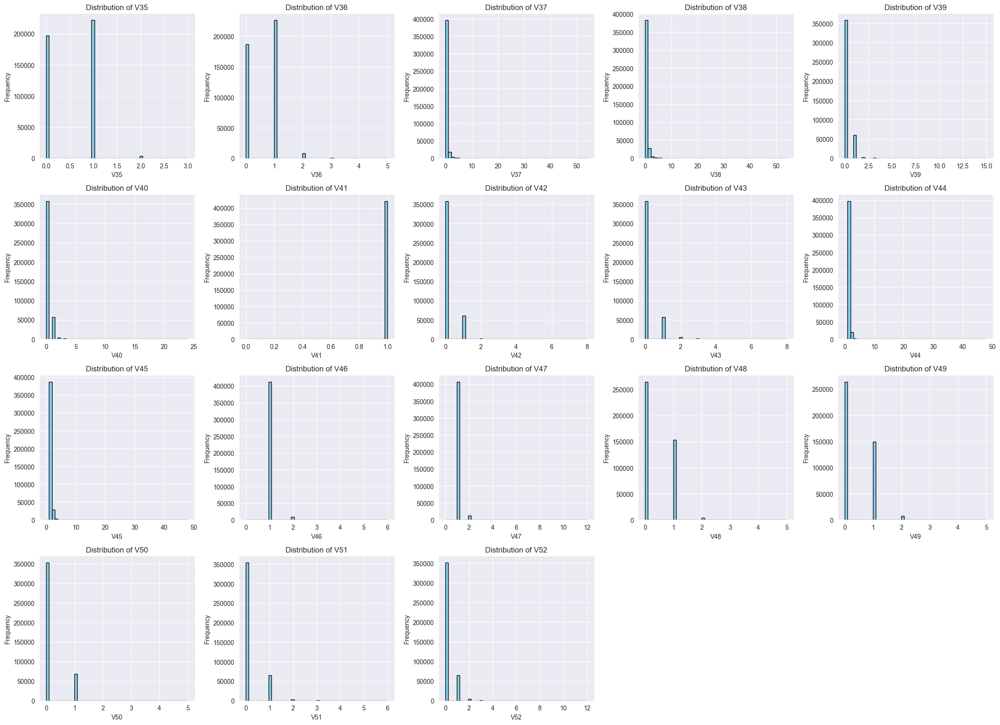

In [31]:
plot_histograms_grid(168969, tr_tr, nan_grouping)

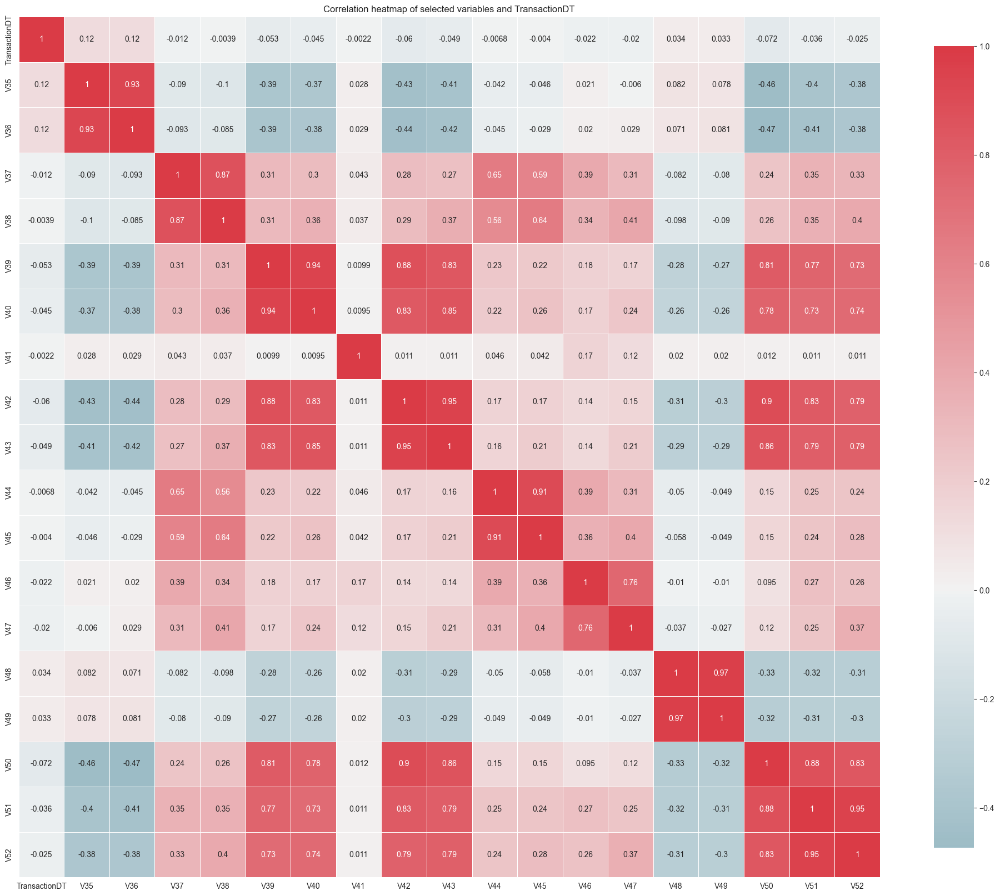

In [32]:
plot_heatmap(168969, tr_tr, nan_grouping, 25, 25)

    V35, V36: These variables show a very high correlation with each other (close to 1.0), indicating they are closely related. They don't exhibit as high a correlation with the other variables, which is why they are grouped together.

    V37, V38: These two variables also have a strong correlation with each other. Other variables don't correlate as strongly with them, hence their grouping.

    V39, V40, V42, V43, V50, V51, V52: All these variables exhibit strong correlations with each other, indicating a high degree of relatedness. This is evident from the heatmap where we see multiple dark red squares within this set, suggesting that they move together.

    V41: This variable seems to be independent of the others, as it doesn't have a particularly strong correlation with any other variable. As a result, it stands alone in its group.

    V44, V45: These two variables are highly correlated with each other but don't show as strong correlations with the other variables, justifying their pairing.

    V46, V47: Similarly, these two variables show a strong correlation with each other but not as strongly with other variables, which justifies grouping them together.

    V48, V49: These two variables also exhibit a strong correlation with each other and are thus paired together.

In [33]:
selected_vars, detailed_report = reduce_group_report([[35,36],[37,38],[39,40,42,43,50,51,52],[41],[44,45],[46,47],[48,49]])
print('Use these:', selected_vars)
print('\nReport:\n', detailed_report)
concatenate_with_prefix(variables_final, selected_vars)

Use these: [36, 37, 40, 41, 44, 47, 48]

Report:
 V35 with 4 unique values was not chosen.
V36 with 6 unique values was chosen.

V37 with 55 unique values was chosen.
V38 with 55 unique values was not chosen.

V39 with 16 unique values was not chosen.
V40 with 18 unique values was chosen.
V42 with 9 unique values was not chosen.
V43 with 9 unique values was not chosen.
V50 with 6 unique values was not chosen.
V51 with 7 unique values was not chosen.
V52 with 9 unique values was not chosen.

V41 with 2 unique values was chosen.

V44 with 49 unique values was chosen.
V45 with 49 unique values was not chosen.

V46 with 7 unique values was not chosen.
V47 with 9 unique values was chosen.

V48 with 6 unique values was chosen.
V49 with 6 unique values was not chosen.


['D4',
 'C13',
 'C14',
 'addr2',
 'M5',
 'D13',
 'D10',
 'ProductCD',
 'card4',
 'D11',
 'C12',
 'M4',
 'M2',
 'P_emaildomain',
 'card5',
 'addr1',
 'D8',
 'D2',
 'D3',
 'M8',
 'M7',
 'D15',
 'D7',
 'C8',
 'M3',
 'D1',
 'dist1',
 'C3',
 'C2',
 'D9',
 'C6',
 'R_emaildomain',
 'card2',
 'C11',
 'TransactionID',
 'TransactionAmt',
 'dist2',
 'C9',
 'D5',
 'M6',
 'card6',
 'C7',
 'C5',
 'D14',
 'card3',
 'D12',
 'card1',
 'D6',
 'isFraud',
 'TransactionDT',
 'C10',
 'C4',
 'C1',
 'M1',
 'M9',
 'V281',
 'V283',
 'V289',
 'V296',
 'V301',
 'V314',
 'V1',
 'V3',
 'V4',
 'V6',
 'V8',
 'V11',
 'V13',
 'V14',
 'V17',
 'V20',
 'V23',
 'V26',
 'V27',
 'V30',
 'V36',
 'V37',
 'V40',
 'V41',
 'V44',
 'V47',
 'V48']

# Missing values = 77096.
## V53 - V74

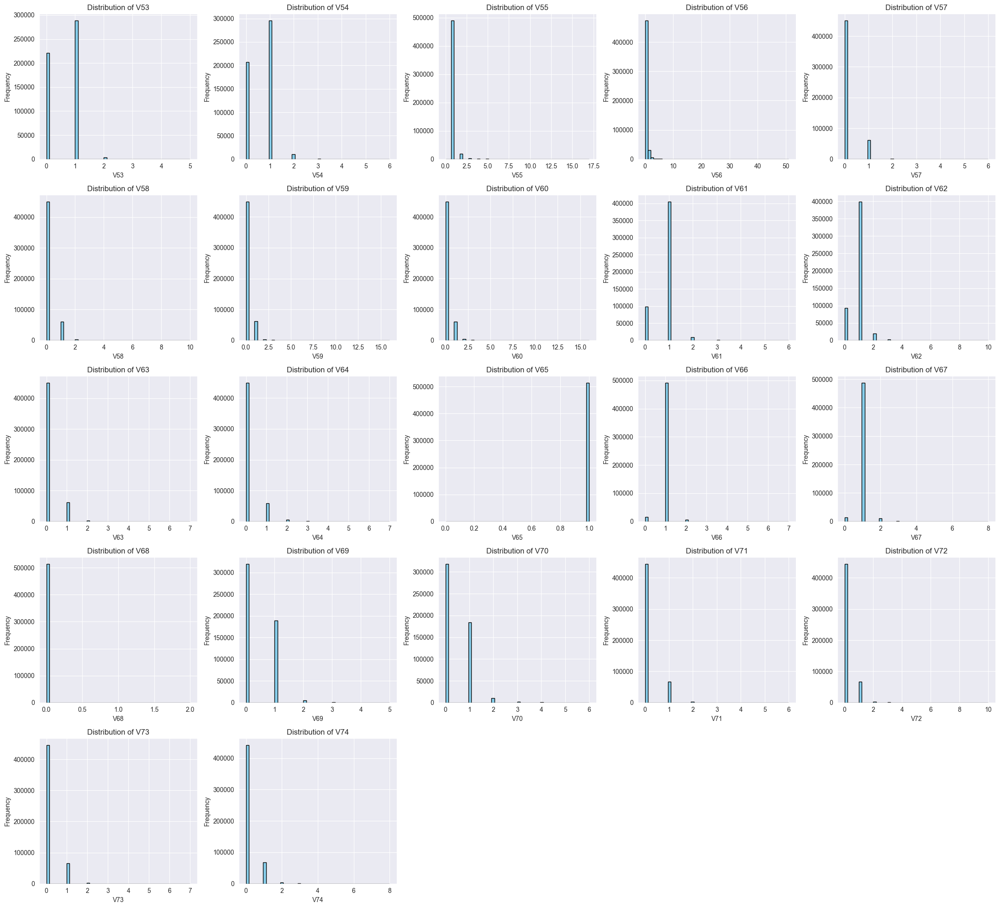

In [34]:
plot_histograms_grid(77096, tr_tr, nan_grouping)

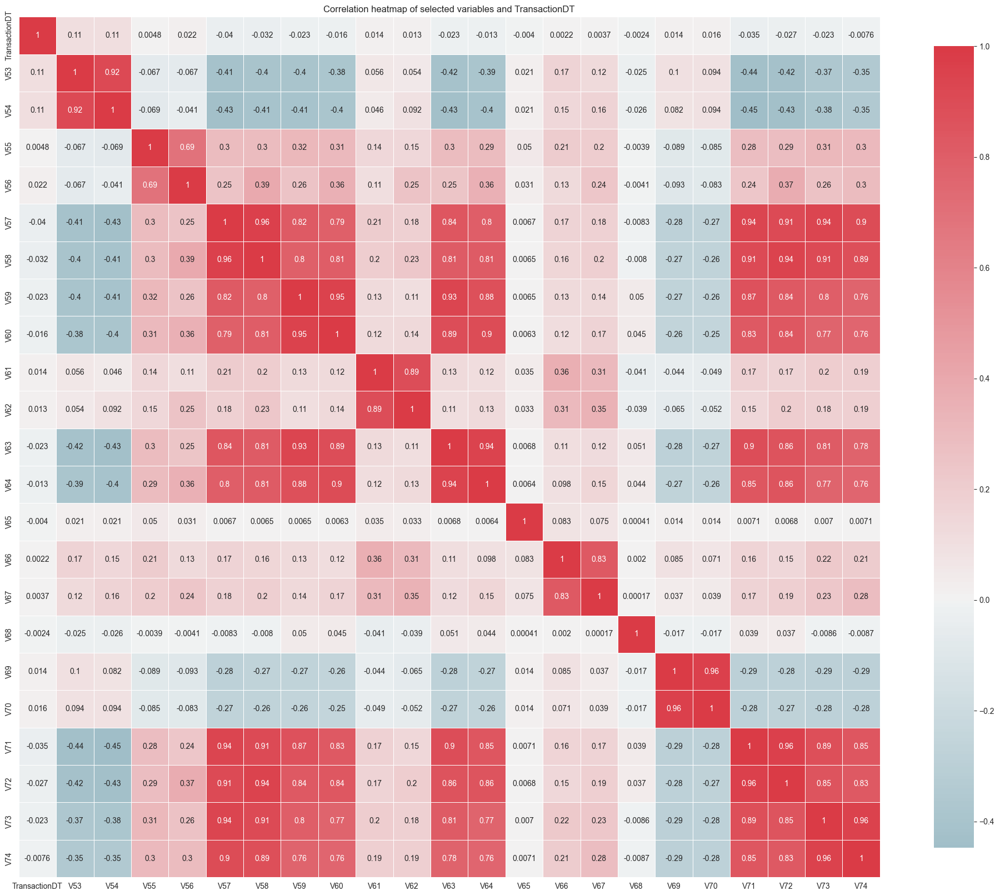

In [35]:
plot_heatmap(77096, tr_tr, nan_grouping, 25, 25)

    V53, V54: These variables exhibit a high correlation with each other, which is close to 1.0. They are grouped together because of their close relation and don't have as high correlations with the other variables.

    V55, V56: These two variables also display a strong correlation with each other. The other variables don't correlate as strongly with them, hence their distinct grouping.

    V57, V58, V59, V60, V63, V64, V71, V72, V73, V74: All these variables manifest strong correlations amongst themselves. This is clear from the heatmap where we see several dark red squares within this set, implying that they are closely related and tend to move together.

    V61, V62: These two variables are closely related to each other based on their strong correlation. They don't have equally high correlations with the other variables, which justifies their separate grouping.

    V65: This variable does not show a strong correlation with the others, hence it is set aside as an independent group.

    V66, V67: These two variables are highly correlated with each other but don't exhibit as strong correlations with the other variables. This strong relationship justifies their pairing.

    V68: Like V65, this variable is also independent from the rest, as evidenced by its lack of strong correlations with other variables.

    V69, V70: Both variables show a strong correlation with each other but not as strongly with other variables. This high correlation justifies their pairing.

In [36]:
selected_vars, detailed_report = reduce_group_report([[53,54],[55,56],[57,58,59,60,63,64,71,72,73,74],[61,62],[65],[66,67],[68],[69,70]])
print('Use these:', selected_vars)
print('\nReport:\n', detailed_report)
concatenate_with_prefix(variables_final, selected_vars)

Use these: [54, 56, 59, 62, 65, 67, 68, 70]

Report:
 V53 with 6 unique values was not chosen.
V54 with 7 unique values was chosen.

V55 with 18 unique values was not chosen.
V56 with 52 unique values was chosen.

V57 with 7 unique values was not chosen.
V58 with 11 unique values was not chosen.
V59 with 17 unique values was chosen.
V60 with 17 unique values was not chosen.
V63 with 8 unique values was not chosen.
V64 with 8 unique values was not chosen.
V71 with 7 unique values was not chosen.
V72 with 11 unique values was not chosen.
V73 with 8 unique values was not chosen.
V74 with 9 unique values was not chosen.

V61 with 7 unique values was not chosen.
V62 with 11 unique values was chosen.

V65 with 2 unique values was chosen.

V66 with 8 unique values was not chosen.
V67 with 9 unique values was chosen.

V68 with 3 unique values was chosen.

V69 with 6 unique values was not chosen.
V70 with 7 unique values was chosen.


['D4',
 'C13',
 'C14',
 'addr2',
 'M5',
 'D13',
 'D10',
 'ProductCD',
 'card4',
 'D11',
 'C12',
 'M4',
 'M2',
 'P_emaildomain',
 'card5',
 'addr1',
 'D8',
 'D2',
 'D3',
 'M8',
 'M7',
 'D15',
 'D7',
 'C8',
 'M3',
 'D1',
 'dist1',
 'C3',
 'C2',
 'D9',
 'C6',
 'R_emaildomain',
 'card2',
 'C11',
 'TransactionID',
 'TransactionAmt',
 'dist2',
 'C9',
 'D5',
 'M6',
 'card6',
 'C7',
 'C5',
 'D14',
 'card3',
 'D12',
 'card1',
 'D6',
 'isFraud',
 'TransactionDT',
 'C10',
 'C4',
 'C1',
 'M1',
 'M9',
 'V281',
 'V283',
 'V289',
 'V296',
 'V301',
 'V314',
 'V1',
 'V3',
 'V4',
 'V6',
 'V8',
 'V11',
 'V13',
 'V14',
 'V17',
 'V20',
 'V23',
 'V26',
 'V27',
 'V30',
 'V36',
 'V37',
 'V40',
 'V41',
 'V44',
 'V47',
 'V48',
 'V54',
 'V56',
 'V59',
 'V62',
 'V65',
 'V67',
 'V68',
 'V70']

# Missing values = 89164.
## V75 - V94

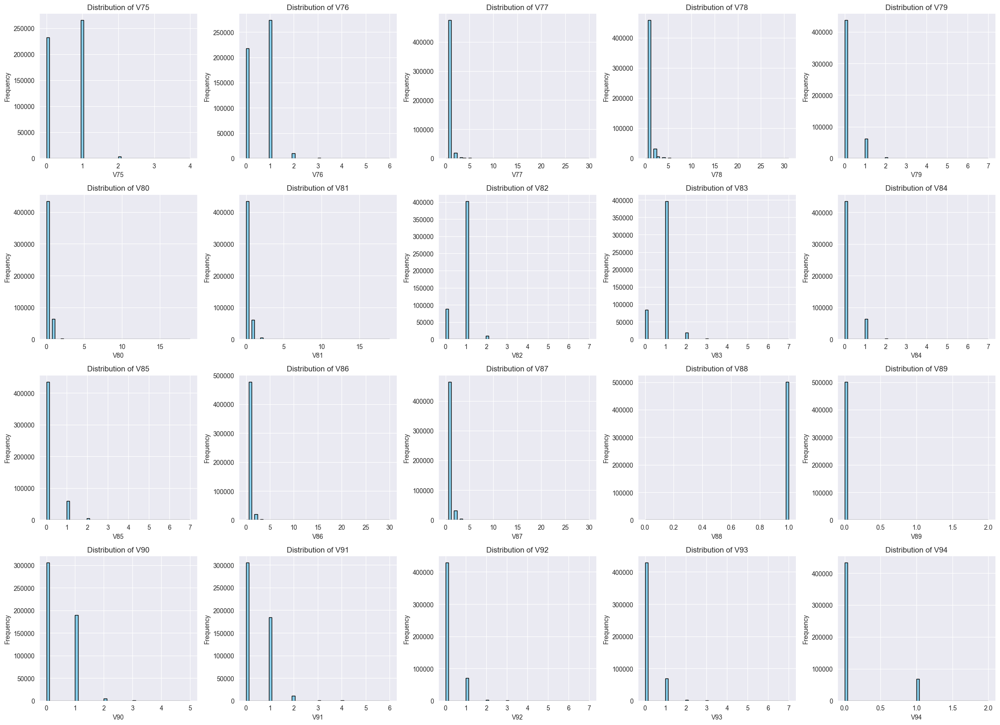

In [37]:
plot_histograms_grid(89164, tr_tr, nan_grouping)

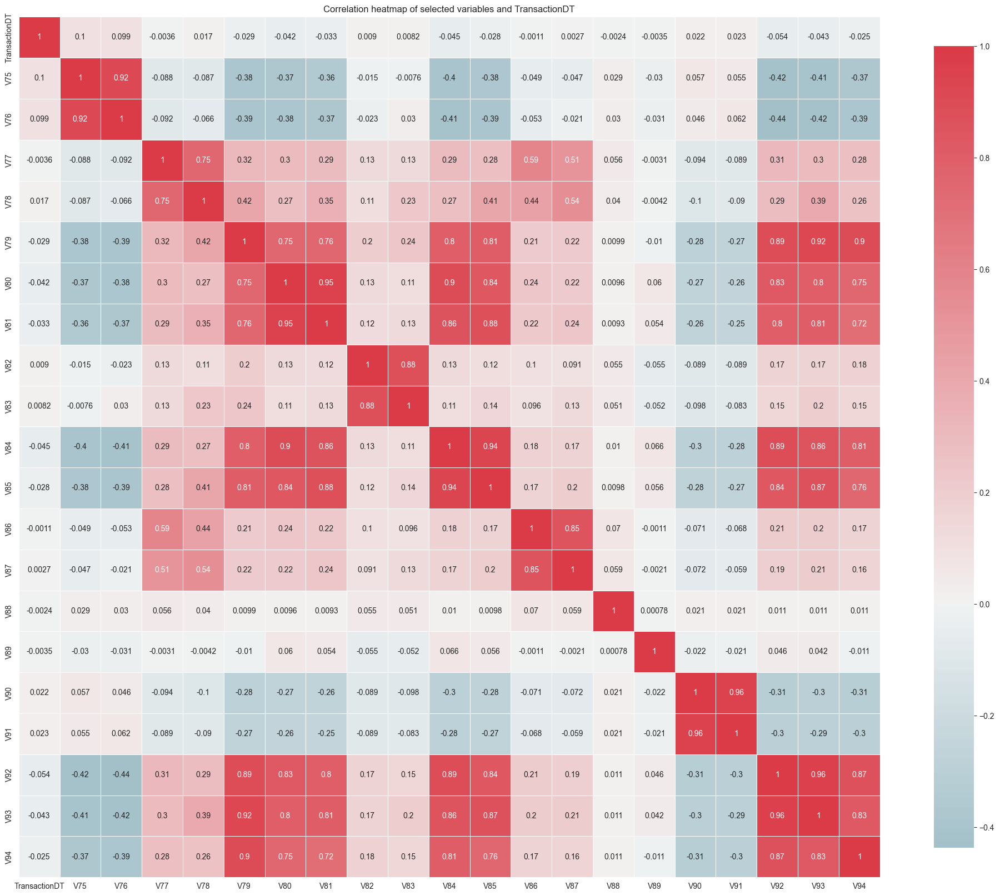

In [38]:
plot_heatmap(89164, tr_tr, nan_grouping, 25, 25)

    V75, V76: These two variables are highly correlated with each other, as indicated by the dark red square. They don't have as high correlations with the other variables, which justifies their grouping together.

    V77, V78: Similarly, these two variables exhibit a strong correlation with each other. Other variables don't correlate as strongly with them, which makes them a distinct pair.

    V79, V80, V81, V84, V85, V92, V93, V94: This group of variables displays strong correlations amongst themselves. The heatmap shows several dark red squares within this set, indicating that they are closely related and tend to move together.

    V82, V83: These two variables are closely related based on their strong correlation. They don't have as high correlations with the other variables, hence they are grouped together.

    V86, V87: These two variables are highly correlated with each other, which is apparent from the dark red square between them. They don't exhibit equally high correlations with other variables, which justifies their pairing.

    V88: This variable does not show a strong correlation with the others, making it stand as an independent group.

    V89: Similar to V88, this variable also does not display strong correlations with other variables, hence it stands alone.

    V90, V91: Both of these variables show a strong correlation with each other but not as strongly with the other variables. This is clear from the dark red square between them, which signifies their close relationship.

In [39]:
selected_vars, detailed_report = reduce_group_report([[75,76],[77,78],[79,80,81,84,85,92,93,94],[82,83],[86,87],[88],[89],[90,91]])
print('Use these:', selected_vars)
print('\nReport:\n', detailed_report)
concatenate_with_prefix(variables_final, selected_vars)

Use these: [76, 78, 80, 82, 86, 88, 89, 91]

Report:
 V75 with 5 unique values was not chosen.
V76 with 7 unique values was chosen.

V77 with 31 unique values was not chosen.
V78 with 32 unique values was chosen.

V79 with 8 unique values was not chosen.
V80 with 20 unique values was chosen.
V81 with 20 unique values was not chosen.
V84 with 8 unique values was not chosen.
V85 with 8 unique values was not chosen.
V92 with 8 unique values was not chosen.
V93 with 8 unique values was not chosen.
V94 with 3 unique values was not chosen.

V82 with 8 unique values was chosen.
V83 with 8 unique values was not chosen.

V86 with 31 unique values was chosen.
V87 with 31 unique values was not chosen.

V88 with 2 unique values was chosen.

V89 with 3 unique values was chosen.

V90 with 6 unique values was not chosen.
V91 with 7 unique values was chosen.


['D4',
 'C13',
 'C14',
 'addr2',
 'M5',
 'D13',
 'D10',
 'ProductCD',
 'card4',
 'D11',
 'C12',
 'M4',
 'M2',
 'P_emaildomain',
 'card5',
 'addr1',
 'D8',
 'D2',
 'D3',
 'M8',
 'M7',
 'D15',
 'D7',
 'C8',
 'M3',
 'D1',
 'dist1',
 'C3',
 'C2',
 'D9',
 'C6',
 'R_emaildomain',
 'card2',
 'C11',
 'TransactionID',
 'TransactionAmt',
 'dist2',
 'C9',
 'D5',
 'M6',
 'card6',
 'C7',
 'C5',
 'D14',
 'card3',
 'D12',
 'card1',
 'D6',
 'isFraud',
 'TransactionDT',
 'C10',
 'C4',
 'C1',
 'M1',
 'M9',
 'V281',
 'V283',
 'V289',
 'V296',
 'V301',
 'V314',
 'V1',
 'V3',
 'V4',
 'V6',
 'V8',
 'V11',
 'V13',
 'V14',
 'V17',
 'V20',
 'V23',
 'V26',
 'V27',
 'V30',
 'V36',
 'V37',
 'V40',
 'V41',
 'V44',
 'V47',
 'V48',
 'V54',
 'V56',
 'V59',
 'V62',
 'V65',
 'V67',
 'V68',
 'V70',
 'V76',
 'V78',
 'V80',
 'V82',
 'V86',
 'V88',
 'V89',
 'V91']

# Missing values = 314.
## V95 - V137

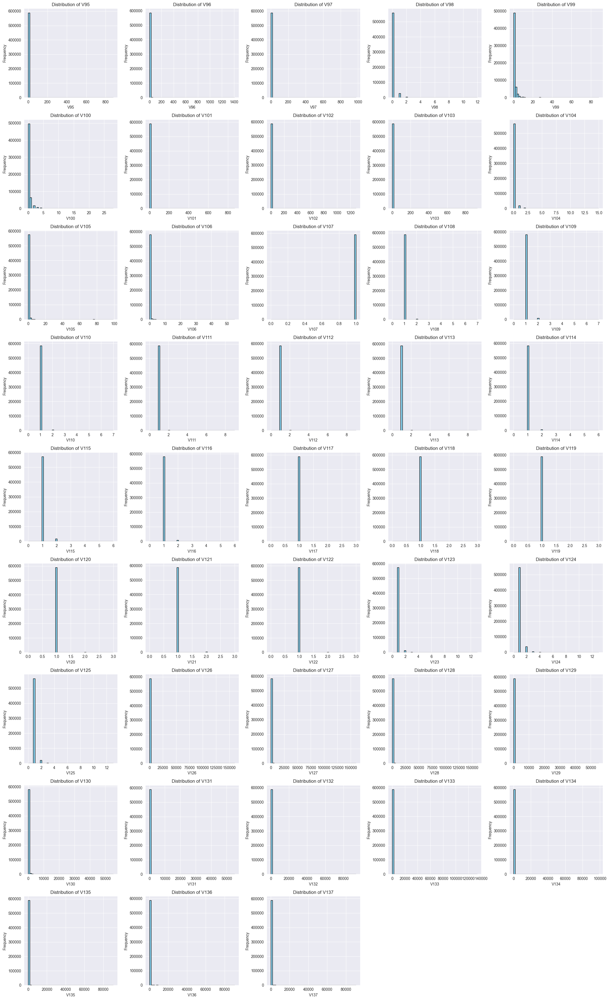

In [40]:
plot_histograms_grid(314, tr_tr, nan_grouping)

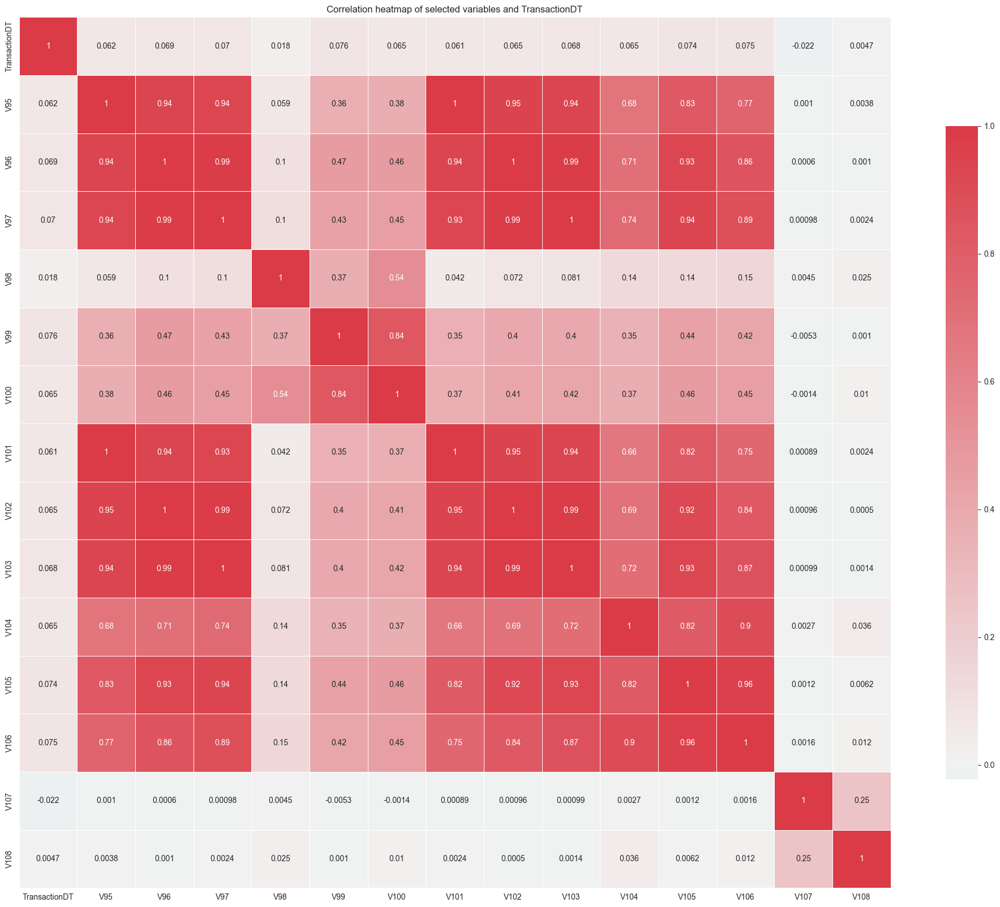

In [41]:
plot_heatmap(314, tr_tr, nan_grouping, 25, 20, split_frac=3, frac_ret=1)

In [42]:
selected_vars, detailed_report = reduce_group_report([[95,96,97,101,102,103,105,106],[98],[99,100],[104],[107],[108]])
print('Use these:', selected_vars)
print('\nReport:\n', detailed_report)
concatenate_with_prefix(variables_final, selected_vars)

Use these: [96, 98, 99, 104, 107, 108]

Report:
 V95 with 881 unique values was not chosen.
V96 with 1410 unique values was chosen.
V97 with 976 unique values was not chosen.
V101 with 870 unique values was not chosen.
V102 with 1285 unique values was not chosen.
V103 with 928 unique values was not chosen.
V105 with 100 unique values was not chosen.
V106 with 56 unique values was not chosen.

V98 with 13 unique values was chosen.

V99 with 89 unique values was chosen.
V100 with 29 unique values was not chosen.

V104 with 16 unique values was chosen.

V107 with 2 unique values was chosen.

V108 with 8 unique values was chosen.


['D4',
 'C13',
 'C14',
 'addr2',
 'M5',
 'D13',
 'D10',
 'ProductCD',
 'card4',
 'D11',
 'C12',
 'M4',
 'M2',
 'P_emaildomain',
 'card5',
 'addr1',
 'D8',
 'D2',
 'D3',
 'M8',
 'M7',
 'D15',
 'D7',
 'C8',
 'M3',
 'D1',
 'dist1',
 'C3',
 'C2',
 'D9',
 'C6',
 'R_emaildomain',
 'card2',
 'C11',
 'TransactionID',
 'TransactionAmt',
 'dist2',
 'C9',
 'D5',
 'M6',
 'card6',
 'C7',
 'C5',
 'D14',
 'card3',
 'D12',
 'card1',
 'D6',
 'isFraud',
 'TransactionDT',
 'C10',
 'C4',
 'C1',
 'M1',
 'M9',
 'V281',
 'V283',
 'V289',
 'V296',
 'V301',
 'V314',
 'V1',
 'V3',
 'V4',
 'V6',
 'V8',
 'V11',
 'V13',
 'V14',
 'V17',
 'V20',
 'V23',
 'V26',
 'V27',
 'V30',
 'V36',
 'V37',
 'V40',
 'V41',
 'V44',
 'V47',
 'V48',
 'V54',
 'V56',
 'V59',
 'V62',
 'V65',
 'V67',
 'V68',
 'V70',
 'V76',
 'V78',
 'V80',
 'V82',
 'V86',
 'V88',
 'V89',
 'V91',
 'V96',
 'V98',
 'V99',
 'V104',
 'V107',
 'V108']

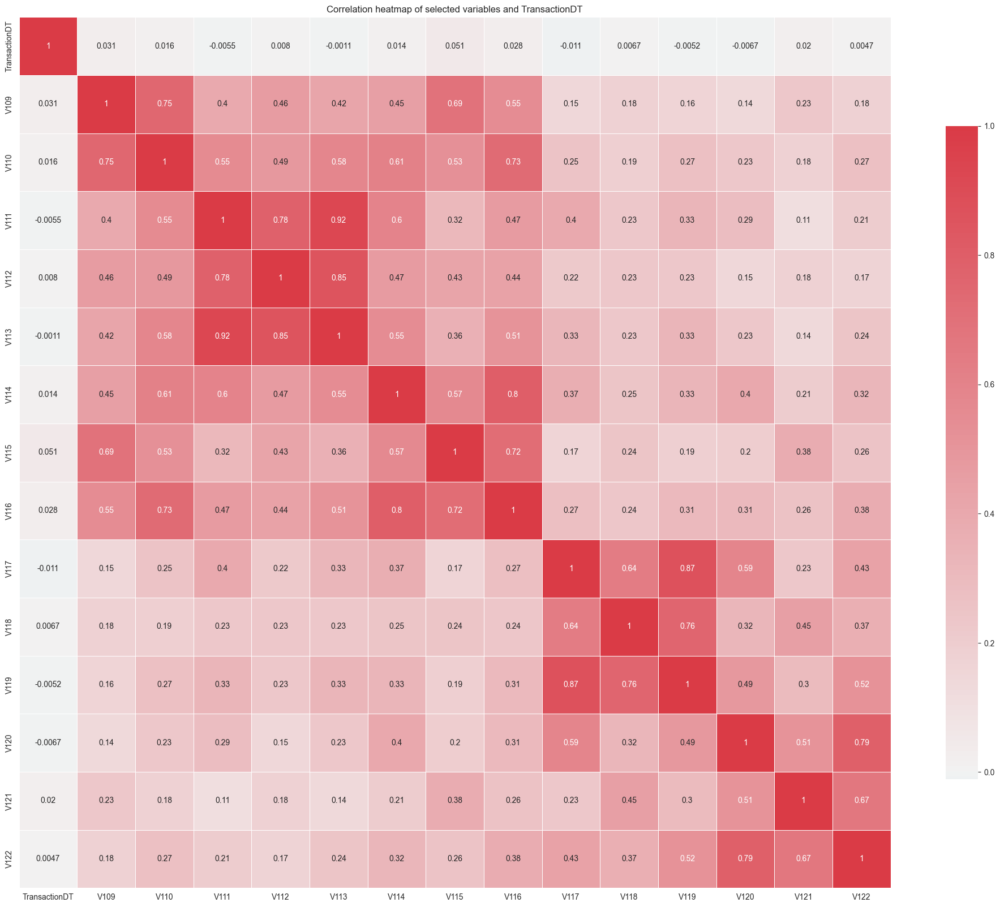

In [43]:
plot_heatmap(314, tr_tr, nan_grouping, 25, 20, split_frac=3, frac_ret=2)

In [44]:
selected_vars, detailed_report = reduce_group_report([[109,110,114],[111,112,113],[115,116],[117,118,119],[120,122],[121]])
print('Use these:', selected_vars)
print('\nReport:\n', detailed_report)
concatenate_with_prefix(variables_final, selected_vars)

Use these: [109, 111, 115, 117, 120, 121]

Report:
 V109 with 8 unique values was chosen.
V110 with 8 unique values was not chosen.
V114 with 7 unique values was not chosen.

V111 with 10 unique values was chosen.
V112 with 10 unique values was not chosen.
V113 with 10 unique values was not chosen.

V115 with 7 unique values was chosen.
V116 with 7 unique values was not chosen.

V117 with 4 unique values was chosen.
V118 with 4 unique values was not chosen.
V119 with 4 unique values was not chosen.

V120 with 4 unique values was chosen.
V122 with 4 unique values was not chosen.

V121 with 4 unique values was chosen.


['D4',
 'C13',
 'C14',
 'addr2',
 'M5',
 'D13',
 'D10',
 'ProductCD',
 'card4',
 'D11',
 'C12',
 'M4',
 'M2',
 'P_emaildomain',
 'card5',
 'addr1',
 'D8',
 'D2',
 'D3',
 'M8',
 'M7',
 'D15',
 'D7',
 'C8',
 'M3',
 'D1',
 'dist1',
 'C3',
 'C2',
 'D9',
 'C6',
 'R_emaildomain',
 'card2',
 'C11',
 'TransactionID',
 'TransactionAmt',
 'dist2',
 'C9',
 'D5',
 'M6',
 'card6',
 'C7',
 'C5',
 'D14',
 'card3',
 'D12',
 'card1',
 'D6',
 'isFraud',
 'TransactionDT',
 'C10',
 'C4',
 'C1',
 'M1',
 'M9',
 'V281',
 'V283',
 'V289',
 'V296',
 'V301',
 'V314',
 'V1',
 'V3',
 'V4',
 'V6',
 'V8',
 'V11',
 'V13',
 'V14',
 'V17',
 'V20',
 'V23',
 'V26',
 'V27',
 'V30',
 'V36',
 'V37',
 'V40',
 'V41',
 'V44',
 'V47',
 'V48',
 'V54',
 'V56',
 'V59',
 'V62',
 'V65',
 'V67',
 'V68',
 'V70',
 'V76',
 'V78',
 'V80',
 'V82',
 'V86',
 'V88',
 'V89',
 'V91',
 'V96',
 'V98',
 'V99',
 'V104',
 'V107',
 'V108',
 'V109',
 'V111',
 'V115',
 'V117',
 'V120',
 'V121']

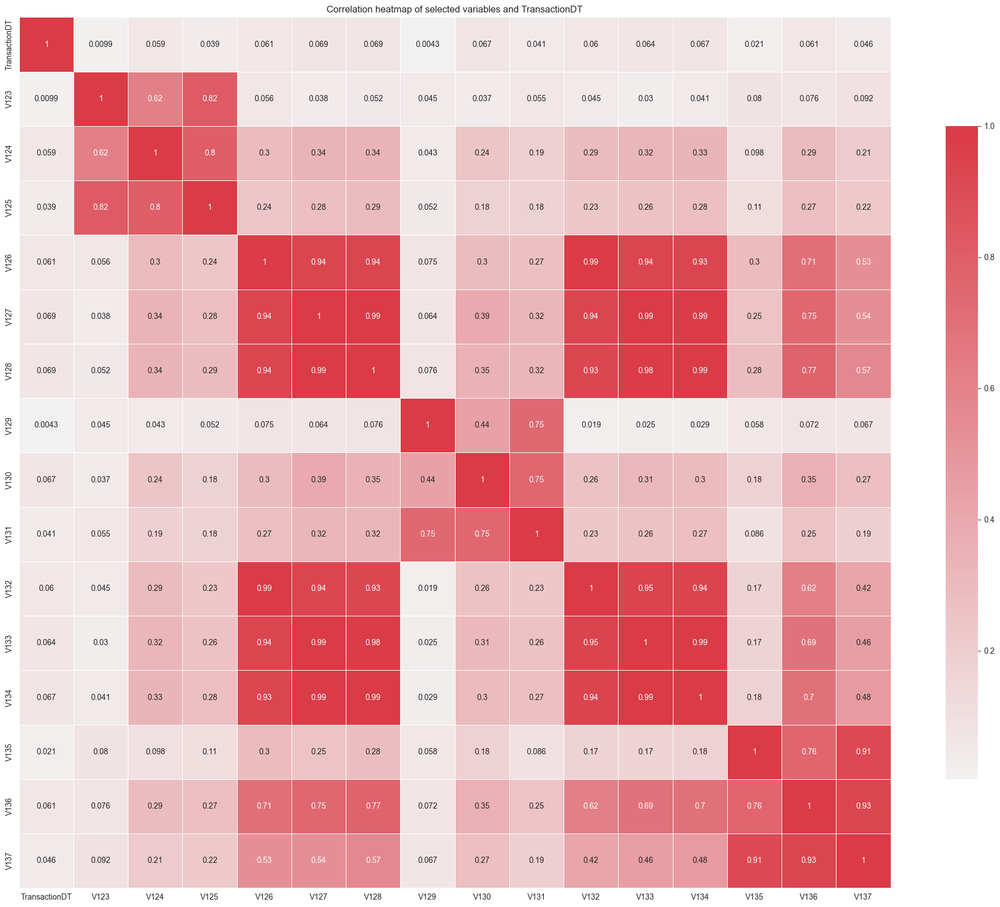

In [45]:
plot_heatmap(314, tr_tr, nan_grouping, 25, 20, split_frac=3, frac_ret=3)

In [46]:
selected_vars, detailed_report = reduce_group_report([[123,124,125],[126,127,128,132,133,134],[129],[130,131],[135,136,137]])
print('Use these:', selected_vars)
print('\nReport:\n', detailed_report)
concatenate_with_prefix(variables_final, selected_vars)

Use these: [123, 127, 129, 130, 136]

Report:
 V123 with 14 unique values was chosen.
V124 with 14 unique values was not chosen.
V125 with 14 unique values was not chosen.

V126 with 10299 unique values was not chosen.
V127 with 24414 unique values was chosen.
V128 with 14507 unique values was not chosen.
V132 with 6560 unique values was not chosen.
V133 with 9949 unique values was not chosen.
V134 with 8178 unique values was not chosen.

V129 with 1968 unique values was chosen.

V130 with 12332 unique values was chosen.
V131 with 4444 unique values was not chosen.

V135 with 3724 unique values was not chosen.
V136 with 4852 unique values was chosen.
V137 with 4252 unique values was not chosen.


['D4',
 'C13',
 'C14',
 'addr2',
 'M5',
 'D13',
 'D10',
 'ProductCD',
 'card4',
 'D11',
 'C12',
 'M4',
 'M2',
 'P_emaildomain',
 'card5',
 'addr1',
 'D8',
 'D2',
 'D3',
 'M8',
 'M7',
 'D15',
 'D7',
 'C8',
 'M3',
 'D1',
 'dist1',
 'C3',
 'C2',
 'D9',
 'C6',
 'R_emaildomain',
 'card2',
 'C11',
 'TransactionID',
 'TransactionAmt',
 'dist2',
 'C9',
 'D5',
 'M6',
 'card6',
 'C7',
 'C5',
 'D14',
 'card3',
 'D12',
 'card1',
 'D6',
 'isFraud',
 'TransactionDT',
 'C10',
 'C4',
 'C1',
 'M1',
 'M9',
 'V281',
 'V283',
 'V289',
 'V296',
 'V301',
 'V314',
 'V1',
 'V3',
 'V4',
 'V6',
 'V8',
 'V11',
 'V13',
 'V14',
 'V17',
 'V20',
 'V23',
 'V26',
 'V27',
 'V30',
 'V36',
 'V37',
 'V40',
 'V41',
 'V44',
 'V47',
 'V48',
 'V54',
 'V56',
 'V59',
 'V62',
 'V65',
 'V67',
 'V68',
 'V70',
 'V76',
 'V78',
 'V80',
 'V82',
 'V86',
 'V88',
 'V89',
 'V91',
 'V96',
 'V98',
 'V99',
 'V104',
 'V107',
 'V108',
 'V109',
 'V111',
 'V115',
 'V117',
 'V120',
 'V121',
 'V123',
 'V127',
 'V129',
 'V130',
 'V136']

Missing values = 508595.
V138 - V142, V146 - V149, V153 - V158, V161 - V163

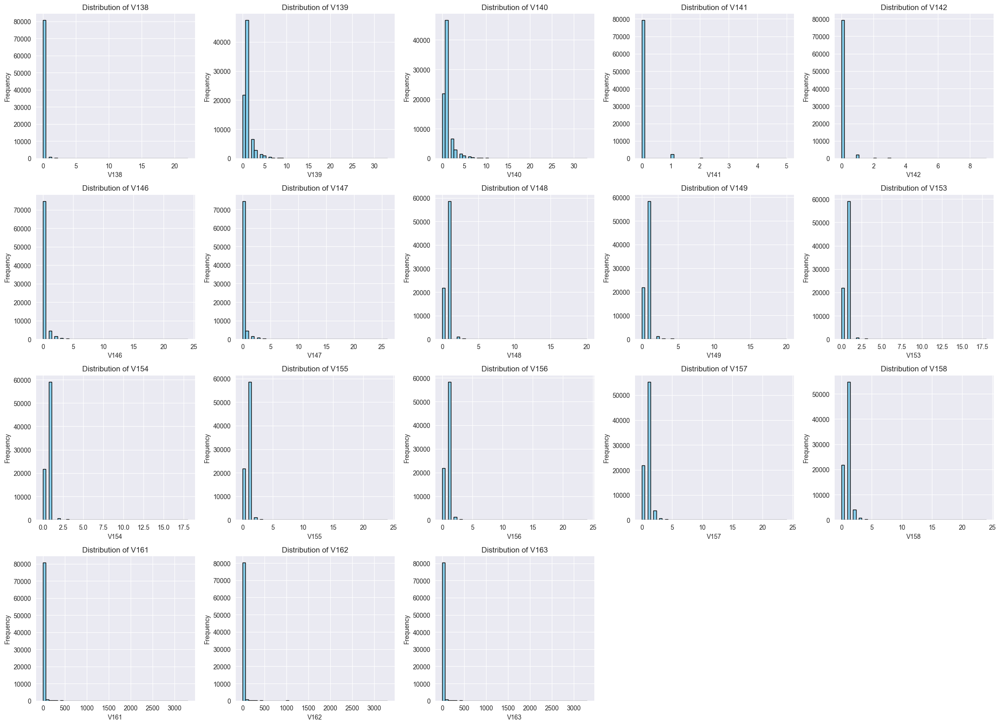

In [47]:
plot_histograms_grid(508595, tr_tr, nan_grouping)

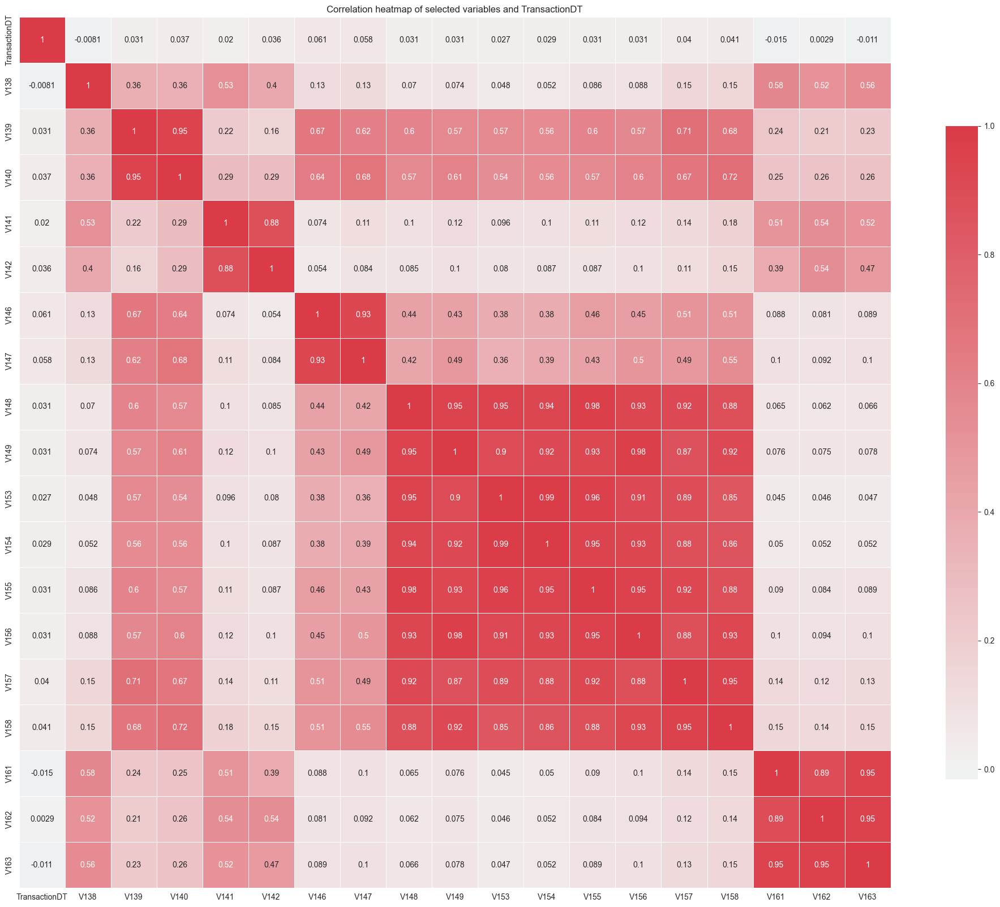

In [48]:
plot_heatmap(508595, tr_tr, nan_grouping, 25, 20)

In [49]:
selected_vars, detailed_report = reduce_group_report([[138],[139,140],[141,142],[146,147],[148,149,153,154,156,157,158],[161,162,163]])
print('Use these:', selected_vars)
print('\nReport:\n', detailed_report)
concatenate_with_prefix(variables_final, selected_vars)

Use these: [138, 139, 142, 147, 156, 162]

Report:
 V138 with 23 unique values was chosen.

V139 with 34 unique values was chosen.
V140 with 34 unique values was not chosen.

V141 with 6 unique values was not chosen.
V142 with 10 unique values was chosen.

V146 with 25 unique values was not chosen.
V147 with 27 unique values was chosen.

V148 with 21 unique values was not chosen.
V149 with 21 unique values was not chosen.
V153 with 19 unique values was not chosen.
V154 with 19 unique values was not chosen.
V156 with 25 unique values was chosen.
V157 with 25 unique values was not chosen.
V158 with 25 unique values was not chosen.

V161 with 79 unique values was not chosen.
V162 with 185 unique values was chosen.
V163 with 106 unique values was not chosen.


['D4',
 'C13',
 'C14',
 'addr2',
 'M5',
 'D13',
 'D10',
 'ProductCD',
 'card4',
 'D11',
 'C12',
 'M4',
 'M2',
 'P_emaildomain',
 'card5',
 'addr1',
 'D8',
 'D2',
 'D3',
 'M8',
 'M7',
 'D15',
 'D7',
 'C8',
 'M3',
 'D1',
 'dist1',
 'C3',
 'C2',
 'D9',
 'C6',
 'R_emaildomain',
 'card2',
 'C11',
 'TransactionID',
 'TransactionAmt',
 'dist2',
 'C9',
 'D5',
 'M6',
 'card6',
 'C7',
 'C5',
 'D14',
 'card3',
 'D12',
 'card1',
 'D6',
 'isFraud',
 'TransactionDT',
 'C10',
 'C4',
 'C1',
 'M1',
 'M9',
 'V281',
 'V283',
 'V289',
 'V296',
 'V301',
 'V314',
 'V1',
 'V3',
 'V4',
 'V6',
 'V8',
 'V11',
 'V13',
 'V14',
 'V17',
 'V20',
 'V23',
 'V26',
 'V27',
 'V30',
 'V36',
 'V37',
 'V40',
 'V41',
 'V44',
 'V47',
 'V48',
 'V54',
 'V56',
 'V59',
 'V62',
 'V65',
 'V67',
 'V68',
 'V70',
 'V76',
 'V78',
 'V80',
 'V82',
 'V86',
 'V88',
 'V89',
 'V91',
 'V96',
 'V98',
 'V99',
 'V104',
 'V107',
 'V108',
 'V109',
 'V111',
 'V115',
 'V117',
 'V120',
 'V121',
 'V123',
 'V127',
 'V129',
 'V130',
 'V136',
 'V138',
 '

Missing values = 508589.
V143 - V145, V150 - V152, V159 - V160, V164 - V165

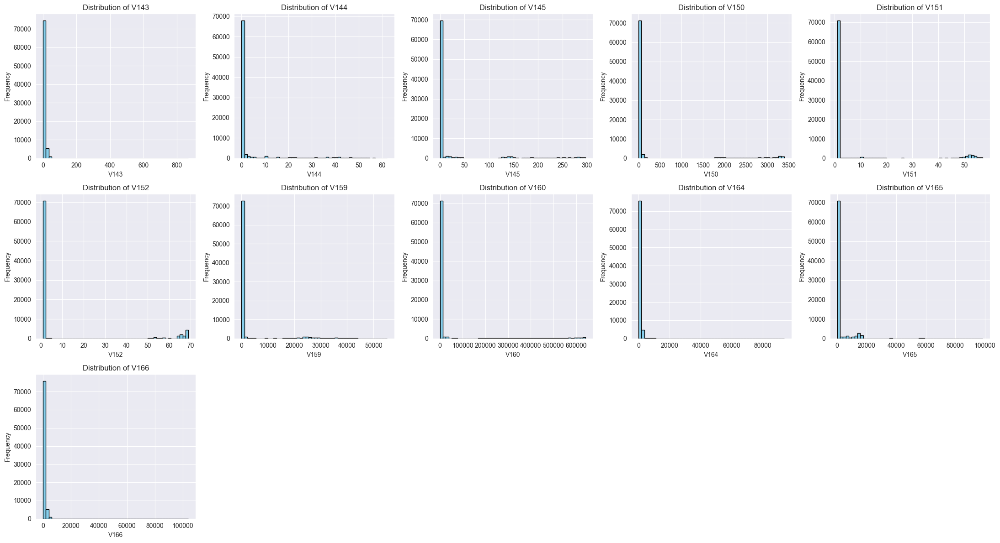

In [50]:
plot_histograms_grid(508589, tr_tr, nan_grouping)

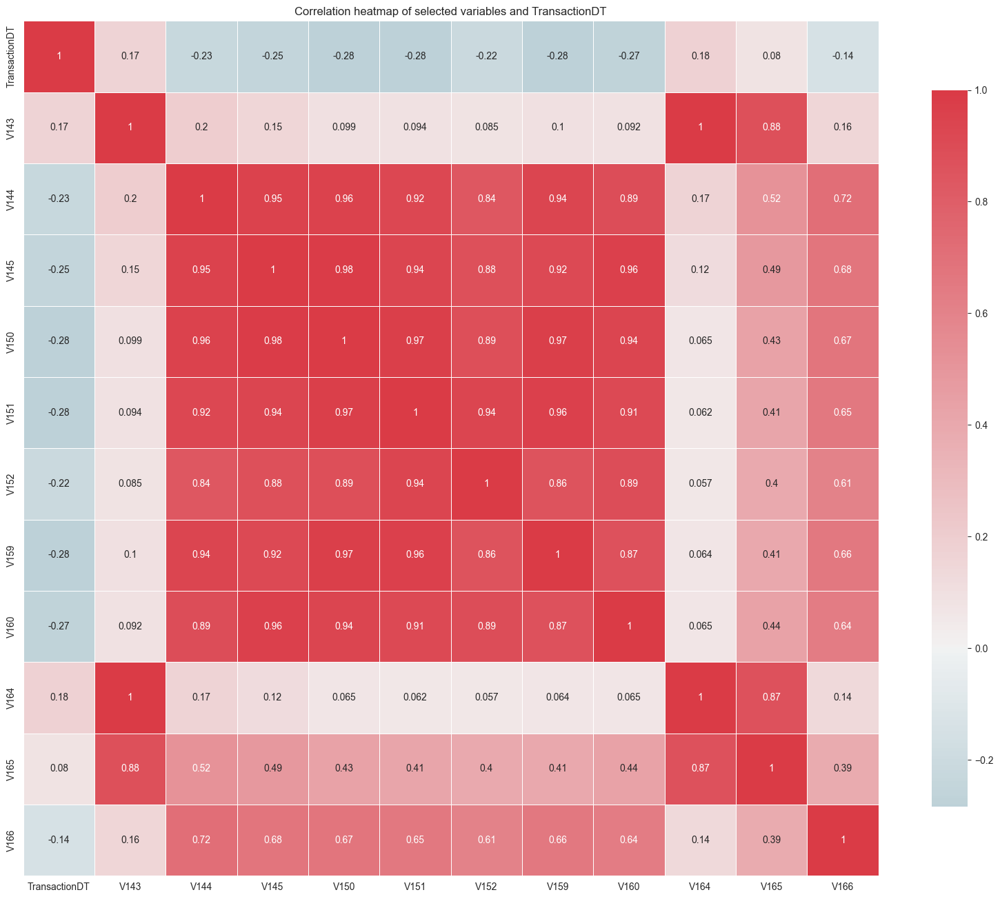

In [52]:
plot_heatmap(508589, tr_tr, nan_grouping, 20, 18)

In [53]:
selected_vars, detailed_report = reduce_group_report([[143,164,165],[144,145,150,151,152,159,160],[166]])
print('Use these:', selected_vars)
print('\nReport:\n', detailed_report)
concatenate_with_prefix(variables_final, selected_vars)

Use these: [165, 160, 166]

Report:
 V143 with 870 unique values was not chosen.
V164 with 1978 unique values was not chosen.
V165 with 2547 unique values was chosen.

V144 with 63 unique values was not chosen.
V145 with 260 unique values was not chosen.
V150 with 1996 unique values was not chosen.
V151 with 56 unique values was not chosen.
V152 with 39 unique values was not chosen.
V159 with 6663 unique values was not chosen.
V160 with 9621 unique values was chosen.

V166 with 987 unique values was chosen.


['D4',
 'C13',
 'C14',
 'addr2',
 'M5',
 'D13',
 'D10',
 'ProductCD',
 'card4',
 'D11',
 'C12',
 'M4',
 'M2',
 'P_emaildomain',
 'card5',
 'addr1',
 'D8',
 'D2',
 'D3',
 'M8',
 'M7',
 'D15',
 'D7',
 'C8',
 'M3',
 'D1',
 'dist1',
 'C3',
 'C2',
 'D9',
 'C6',
 'R_emaildomain',
 'card2',
 'C11',
 'TransactionID',
 'TransactionAmt',
 'dist2',
 'C9',
 'D5',
 'M6',
 'card6',
 'C7',
 'C5',
 'D14',
 'card3',
 'D12',
 'card1',
 'D6',
 'isFraud',
 'TransactionDT',
 'C10',
 'C4',
 'C1',
 'M1',
 'M9',
 'V281',
 'V283',
 'V289',
 'V296',
 'V301',
 'V314',
 'V1',
 'V3',
 'V4',
 'V6',
 'V8',
 'V11',
 'V13',
 'V14',
 'V17',
 'V20',
 'V23',
 'V26',
 'V27',
 'V30',
 'V36',
 'V37',
 'V40',
 'V41',
 'V44',
 'V47',
 'V48',
 'V54',
 'V56',
 'V59',
 'V62',
 'V65',
 'V67',
 'V68',
 'V70',
 'V76',
 'V78',
 'V80',
 'V82',
 'V86',
 'V88',
 'V89',
 'V91',
 'V96',
 'V98',
 'V99',
 'V104',
 'V107',
 'V108',
 'V109',
 'V111',
 'V115',
 'V117',
 'V120',
 'V121',
 'V123',
 'V127',
 'V129',
 'V130',
 'V136',
 'V138',
 '

Missing values = 450909.
V167 - V216

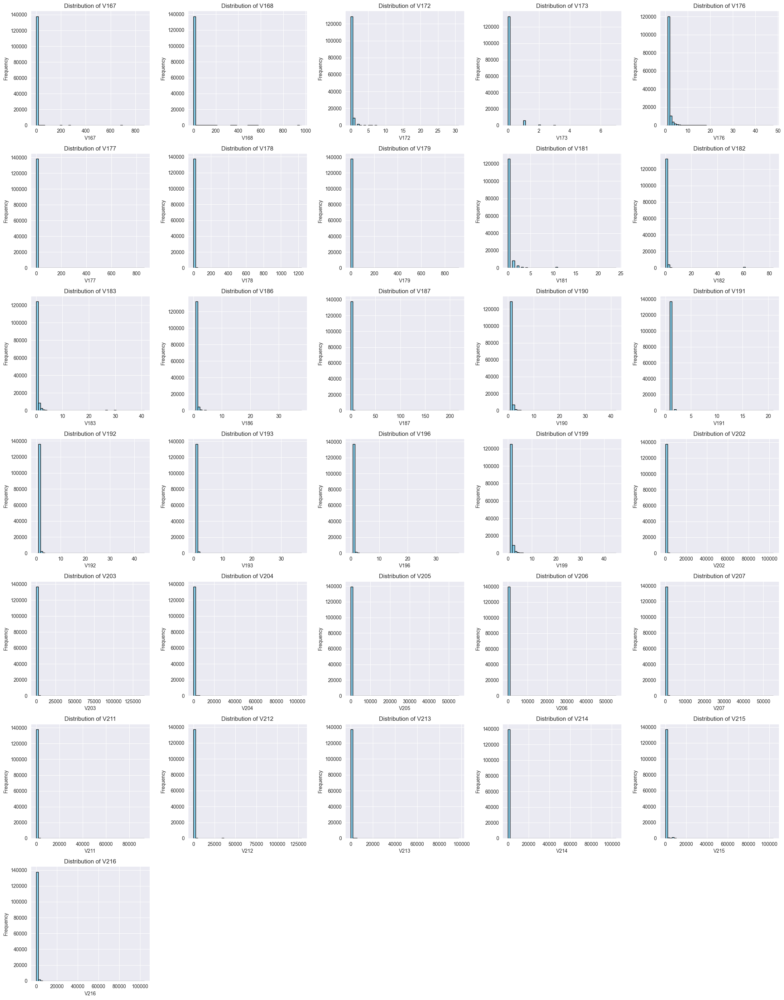

In [55]:
plot_histograms_grid(450909, tr_tr, nan_grouping)

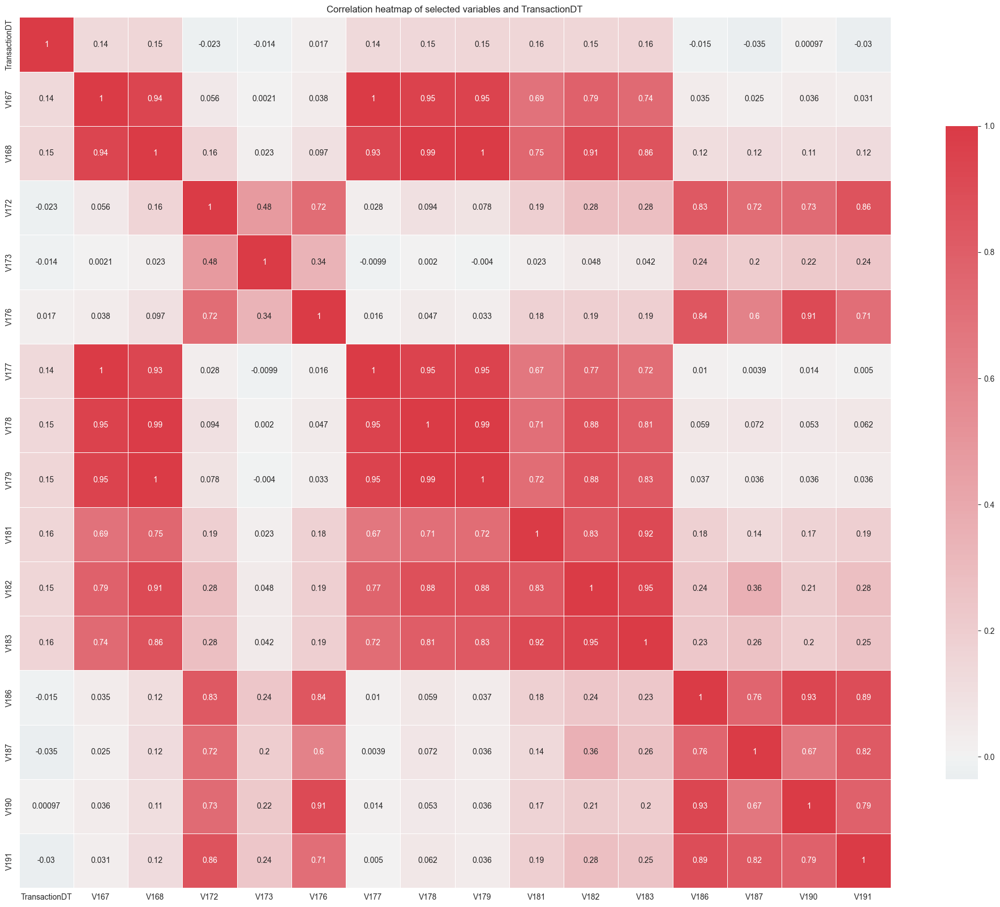

In [57]:
plot_heatmap(450909, tr_tr, nan_grouping, 25, 20, split_frac=2, frac_ret=1)

In [58]:
selected_vars, detailed_report = reduce_group_report([[167,168,177,178,179,181,182,183],[172,176,186,187,190,191],[173],[181,182,183]])
print('Use these:', selected_vars)
print('\nReport:\n', detailed_report)
concatenate_with_prefix(variables_final, selected_vars)

Use these: [178, 187, 173, 182]

Report:
 V167 with 873 unique values was not chosen.
V168 with 965 unique values was not chosen.
V177 with 862 unique values was not chosen.
V178 with 1236 unique values was chosen.
V179 with 921 unique values was not chosen.
V181 with 25 unique values was not chosen.
V182 with 84 unique values was not chosen.
V183 with 42 unique values was not chosen.

V172 with 32 unique values was not chosen.
V176 with 49 unique values was not chosen.
V186 with 39 unique values was not chosen.
V187 with 215 unique values was chosen.
V190 with 43 unique values was not chosen.
V191 with 22 unique values was not chosen.

V173 with 8 unique values was chosen.

V181 with 25 unique values was not chosen.
V182 with 84 unique values was chosen.
V183 with 42 unique values was not chosen.


['D4',
 'C13',
 'C14',
 'addr2',
 'M5',
 'D13',
 'D10',
 'ProductCD',
 'card4',
 'D11',
 'C12',
 'M4',
 'M2',
 'P_emaildomain',
 'card5',
 'addr1',
 'D8',
 'D2',
 'D3',
 'M8',
 'M7',
 'D15',
 'D7',
 'C8',
 'M3',
 'D1',
 'dist1',
 'C3',
 'C2',
 'D9',
 'C6',
 'R_emaildomain',
 'card2',
 'C11',
 'TransactionID',
 'TransactionAmt',
 'dist2',
 'C9',
 'D5',
 'M6',
 'card6',
 'C7',
 'C5',
 'D14',
 'card3',
 'D12',
 'card1',
 'D6',
 'isFraud',
 'TransactionDT',
 'C10',
 'C4',
 'C1',
 'M1',
 'M9',
 'V281',
 'V283',
 'V289',
 'V296',
 'V301',
 'V314',
 'V1',
 'V3',
 'V4',
 'V6',
 'V8',
 'V11',
 'V13',
 'V14',
 'V17',
 'V20',
 'V23',
 'V26',
 'V27',
 'V30',
 'V36',
 'V37',
 'V40',
 'V41',
 'V44',
 'V47',
 'V48',
 'V54',
 'V56',
 'V59',
 'V62',
 'V65',
 'V67',
 'V68',
 'V70',
 'V76',
 'V78',
 'V80',
 'V82',
 'V86',
 'V88',
 'V89',
 'V91',
 'V96',
 'V98',
 'V99',
 'V104',
 'V107',
 'V108',
 'V109',
 'V111',
 'V115',
 'V117',
 'V120',
 'V121',
 'V123',
 'V127',
 'V129',
 'V130',
 'V136',
 'V138',
 '

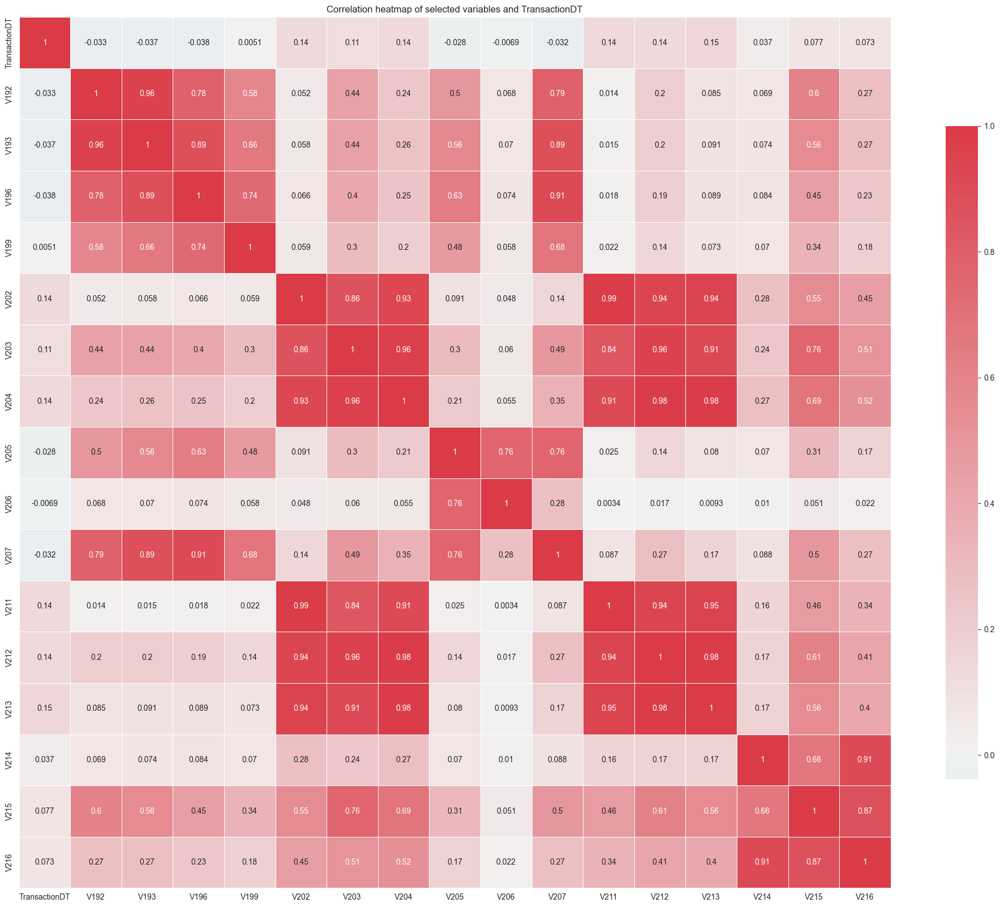

In [59]:
plot_heatmap(450909, tr_tr, nan_grouping, 25, 20, split_frac=2, frac_ret=2)

In [60]:
selected_vars, detailed_report = reduce_group_report([[192,193,196,199],[202,203,204,211,212,213],[205,206],[207],[214,215,216]])
print('Use these:', selected_vars)
print('\nReport:\n', detailed_report)
concatenate_with_prefix(variables_final, selected_vars)

Use these: [199, 203, 205, 207, 215]

Report:
 V192 with 45 unique values was not chosen.
V193 with 38 unique values was not chosen.
V196 with 39 unique values was not chosen.
V199 with 46 unique values was chosen.

V202 with 10970 unique values was not chosen.
V203 with 14951 unique values was chosen.
V204 with 12858 unique values was not chosen.
V211 with 7624 unique values was not chosen.
V212 with 8868 unique values was not chosen.
V213 with 8317 unique values was not chosen.

V205 with 2240 unique values was chosen.
V206 with 1780 unique values was not chosen.

V207 with 3246 unique values was chosen.

V214 with 2282 unique values was not chosen.
V215 with 2747 unique values was chosen.
V216 with 2532 unique values was not chosen.


['D4',
 'C13',
 'C14',
 'addr2',
 'M5',
 'D13',
 'D10',
 'ProductCD',
 'card4',
 'D11',
 'C12',
 'M4',
 'M2',
 'P_emaildomain',
 'card5',
 'addr1',
 'D8',
 'D2',
 'D3',
 'M8',
 'M7',
 'D15',
 'D7',
 'C8',
 'M3',
 'D1',
 'dist1',
 'C3',
 'C2',
 'D9',
 'C6',
 'R_emaildomain',
 'card2',
 'C11',
 'TransactionID',
 'TransactionAmt',
 'dist2',
 'C9',
 'D5',
 'M6',
 'card6',
 'C7',
 'C5',
 'D14',
 'card3',
 'D12',
 'card1',
 'D6',
 'isFraud',
 'TransactionDT',
 'C10',
 'C4',
 'C1',
 'M1',
 'M9',
 'V281',
 'V283',
 'V289',
 'V296',
 'V301',
 'V314',
 'V1',
 'V3',
 'V4',
 'V6',
 'V8',
 'V11',
 'V13',
 'V14',
 'V17',
 'V20',
 'V23',
 'V26',
 'V27',
 'V30',
 'V36',
 'V37',
 'V40',
 'V41',
 'V44',
 'V47',
 'V48',
 'V54',
 'V56',
 'V59',
 'V62',
 'V65',
 'V67',
 'V68',
 'V70',
 'V76',
 'V78',
 'V80',
 'V82',
 'V86',
 'V88',
 'V89',
 'V91',
 'V96',
 'V98',
 'V99',
 'V104',
 'V107',
 'V108',
 'V109',
 'V111',
 'V115',
 'V117',
 'V120',
 'V121',
 'V123',
 'V127',
 'V129',
 'V130',
 'V136',
 'V138',
 '

Missing values = 460110.
V217 - V278

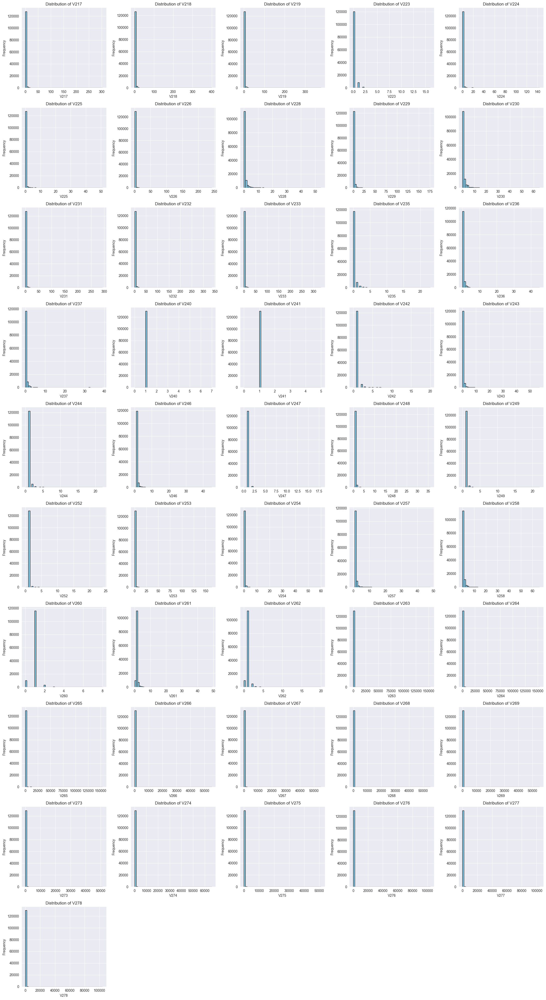

In [61]:
plot_histograms_grid(460110, tr_tr, nan_grouping)

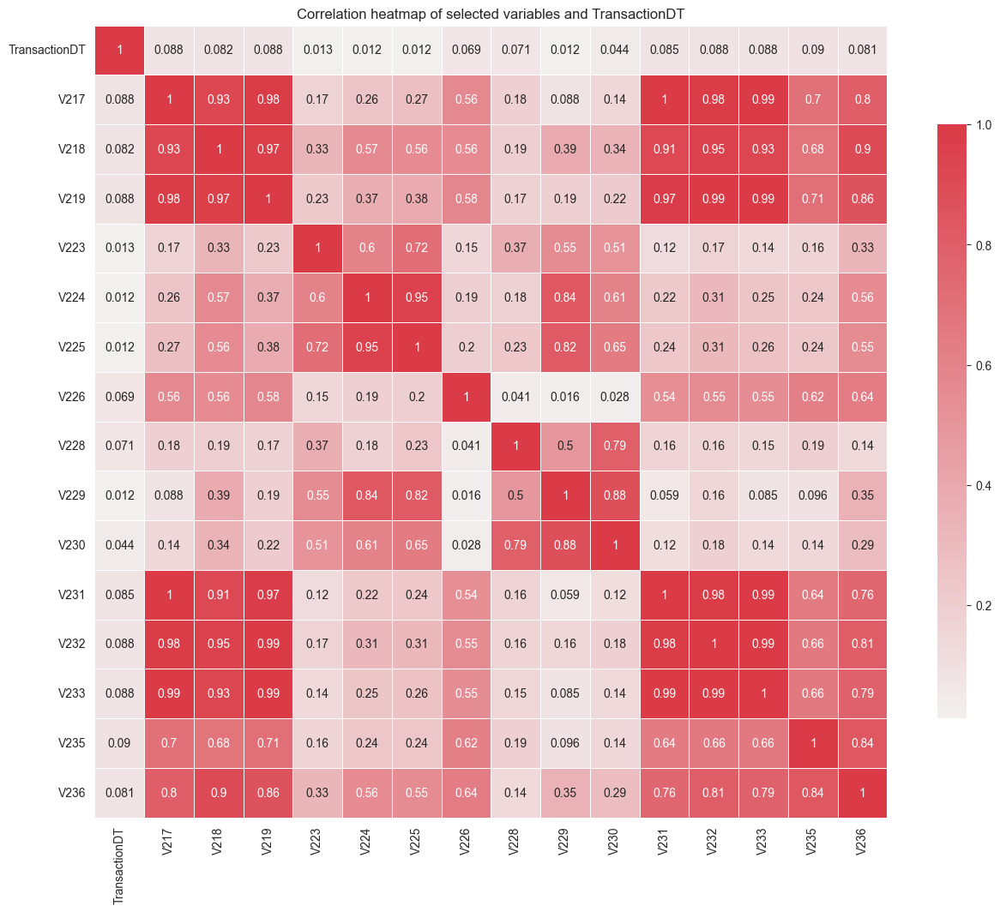

In [65]:
plot_heatmap(460110, tr_tr, nan_grouping, 15, 12, split_frac=3, frac_ret=1)

In [66]:
selected_vars, detailed_report = reduce_group_report([[217,218,219,231,232,233,236],[223],[224,225],[226],[228],[229,230],[235]])
print('Use these:', selected_vars)
print('\nReport:\n', detailed_report)
concatenate_with_prefix(variables_final, selected_vars)

Use these: [218, 223, 224, 226, 228, 229, 235]

Report:
 V217 with 304 unique values was not chosen.
V218 with 401 unique values was chosen.
V219 with 379 unique values was not chosen.
V231 with 294 unique values was not chosen.
V232 with 338 unique values was not chosen.
V233 with 333 unique values was not chosen.
V236 with 46 unique values was not chosen.

V223 with 17 unique values was chosen.

V224 with 79 unique values was chosen.
V225 with 35 unique values was not chosen.

V226 with 81 unique values was chosen.

V228 with 55 unique values was chosen.

V229 with 91 unique values was chosen.
V230 with 66 unique values was not chosen.

V235 with 24 unique values was chosen.


['D4',
 'C13',
 'C14',
 'addr2',
 'M5',
 'D13',
 'D10',
 'ProductCD',
 'card4',
 'D11',
 'C12',
 'M4',
 'M2',
 'P_emaildomain',
 'card5',
 'addr1',
 'D8',
 'D2',
 'D3',
 'M8',
 'M7',
 'D15',
 'D7',
 'C8',
 'M3',
 'D1',
 'dist1',
 'C3',
 'C2',
 'D9',
 'C6',
 'R_emaildomain',
 'card2',
 'C11',
 'TransactionID',
 'TransactionAmt',
 'dist2',
 'C9',
 'D5',
 'M6',
 'card6',
 'C7',
 'C5',
 'D14',
 'card3',
 'D12',
 'card1',
 'D6',
 'isFraud',
 'TransactionDT',
 'C10',
 'C4',
 'C1',
 'M1',
 'M9',
 'V281',
 'V283',
 'V289',
 'V296',
 'V301',
 'V314',
 'V1',
 'V3',
 'V4',
 'V6',
 'V8',
 'V11',
 'V13',
 'V14',
 'V17',
 'V20',
 'V23',
 'V26',
 'V27',
 'V30',
 'V36',
 'V37',
 'V40',
 'V41',
 'V44',
 'V47',
 'V48',
 'V54',
 'V56',
 'V59',
 'V62',
 'V65',
 'V67',
 'V68',
 'V70',
 'V76',
 'V78',
 'V80',
 'V82',
 'V86',
 'V88',
 'V89',
 'V91',
 'V96',
 'V98',
 'V99',
 'V104',
 'V107',
 'V108',
 'V109',
 'V111',
 'V115',
 'V117',
 'V120',
 'V121',
 'V123',
 'V127',
 'V129',
 'V130',
 'V136',
 'V138',
 '

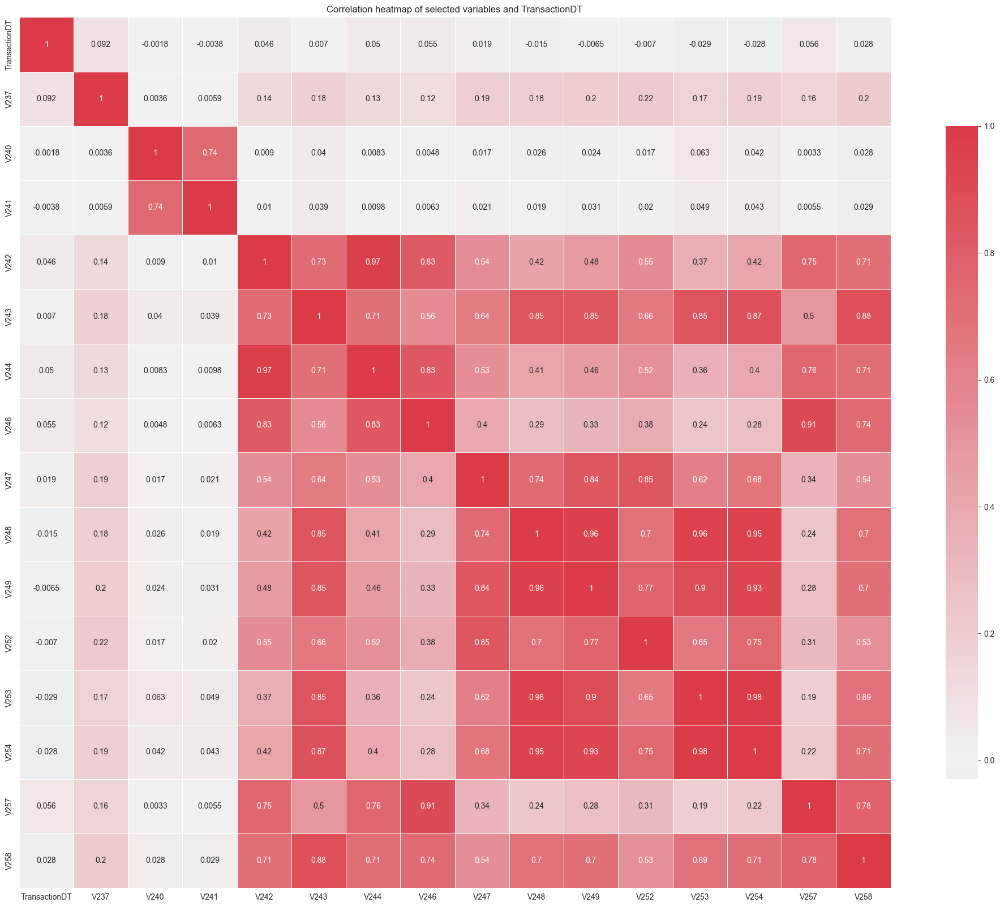

In [67]:
plot_heatmap(460110, tr_tr, nan_grouping, 25, 20, split_frac=3, frac_ret=2)

In [68]:
selected_vars, detailed_report = reduce_group_report([[237],[240,241],[242,243,244,258],[246,257],[247,248,249,253,254],[252]])
print('Use these:', selected_vars)
print('\nReport:\n', detailed_report)
concatenate_with_prefix(variables_final, selected_vars)

Use these: [237, 240, 258, 257, 253, 252]

Report:
 V237 with 40 unique values was chosen.

V240 with 6 unique values was chosen.
V241 with 5 unique values was not chosen.

V242 with 21 unique values was not chosen.
V243 with 43 unique values was not chosen.
V244 with 23 unique values was not chosen.
V258 with 67 unique values was chosen.

V246 with 46 unique values was not chosen.
V257 with 49 unique values was chosen.

V247 with 19 unique values was not chosen.
V248 with 23 unique values was not chosen.
V249 with 23 unique values was not chosen.
V253 with 66 unique values was chosen.
V254 with 45 unique values was not chosen.

V252 with 25 unique values was chosen.


['D4',
 'C13',
 'C14',
 'addr2',
 'M5',
 'D13',
 'D10',
 'ProductCD',
 'card4',
 'D11',
 'C12',
 'M4',
 'M2',
 'P_emaildomain',
 'card5',
 'addr1',
 'D8',
 'D2',
 'D3',
 'M8',
 'M7',
 'D15',
 'D7',
 'C8',
 'M3',
 'D1',
 'dist1',
 'C3',
 'C2',
 'D9',
 'C6',
 'R_emaildomain',
 'card2',
 'C11',
 'TransactionID',
 'TransactionAmt',
 'dist2',
 'C9',
 'D5',
 'M6',
 'card6',
 'C7',
 'C5',
 'D14',
 'card3',
 'D12',
 'card1',
 'D6',
 'isFraud',
 'TransactionDT',
 'C10',
 'C4',
 'C1',
 'M1',
 'M9',
 'V281',
 'V283',
 'V289',
 'V296',
 'V301',
 'V314',
 'V1',
 'V3',
 'V4',
 'V6',
 'V8',
 'V11',
 'V13',
 'V14',
 'V17',
 'V20',
 'V23',
 'V26',
 'V27',
 'V30',
 'V36',
 'V37',
 'V40',
 'V41',
 'V44',
 'V47',
 'V48',
 'V54',
 'V56',
 'V59',
 'V62',
 'V65',
 'V67',
 'V68',
 'V70',
 'V76',
 'V78',
 'V80',
 'V82',
 'V86',
 'V88',
 'V89',
 'V91',
 'V96',
 'V98',
 'V99',
 'V104',
 'V107',
 'V108',
 'V109',
 'V111',
 'V115',
 'V117',
 'V120',
 'V121',
 'V123',
 'V127',
 'V129',
 'V130',
 'V136',
 'V138',
 '

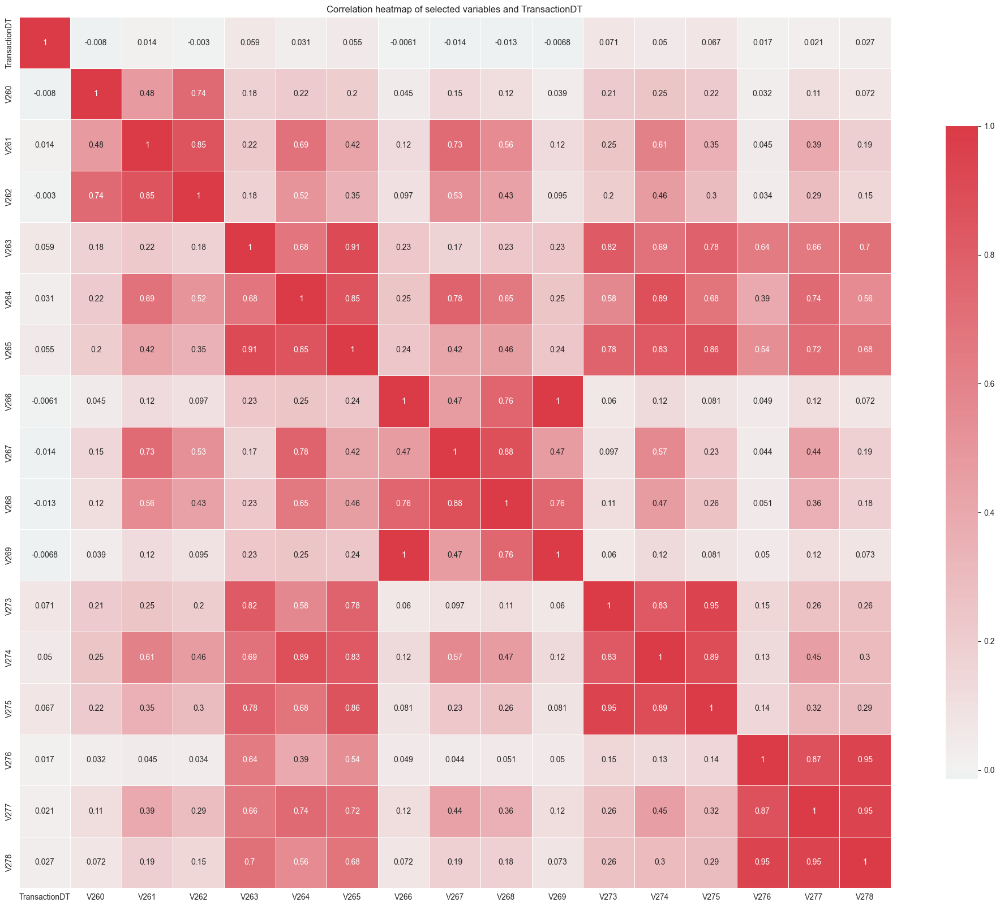

In [69]:
plot_heatmap(460110, tr_tr, nan_grouping, 25, 20, split_frac=3, frac_ret=3)

In [70]:
selected_vars, detailed_report = reduce_group_report([[260],[261,262],[263,265,264],[266,269],[267,268],[273,274,275],[276,277,278]])
print('Use these:', selected_vars)
print('\nReport:\n', detailed_report)
concatenate_with_prefix(variables_final, selected_vars)

Use these: [260, 261, 264, 266, 267, 274, 277]

Report:
 V260 with 9 unique values was chosen.

V261 with 41 unique values was chosen.
V262 with 21 unique values was not chosen.

V263 with 10422 unique values was not chosen.
V265 with 11757 unique values was not chosen.
V264 with 13358 unique values was chosen.

V266 with 2178 unique values was chosen.
V269 with 151 unique values was not chosen.

V267 with 3616 unique values was chosen.
V268 with 2756 unique values was not chosen.

V273 with 7177 unique values was not chosen.
V274 with 8315 unique values was chosen.
V275 with 7776 unique values was not chosen.

V276 with 2263 unique values was not chosen.
V277 with 2540 unique values was chosen.
V278 with 2398 unique values was not chosen.


['D4',
 'C13',
 'C14',
 'addr2',
 'M5',
 'D13',
 'D10',
 'ProductCD',
 'card4',
 'D11',
 'C12',
 'M4',
 'M2',
 'P_emaildomain',
 'card5',
 'addr1',
 'D8',
 'D2',
 'D3',
 'M8',
 'M7',
 'D15',
 'D7',
 'C8',
 'M3',
 'D1',
 'dist1',
 'C3',
 'C2',
 'D9',
 'C6',
 'R_emaildomain',
 'card2',
 'C11',
 'TransactionID',
 'TransactionAmt',
 'dist2',
 'C9',
 'D5',
 'M6',
 'card6',
 'C7',
 'C5',
 'D14',
 'card3',
 'D12',
 'card1',
 'D6',
 'isFraud',
 'TransactionDT',
 'C10',
 'C4',
 'C1',
 'M1',
 'M9',
 'V281',
 'V283',
 'V289',
 'V296',
 'V301',
 'V314',
 'V1',
 'V3',
 'V4',
 'V6',
 'V8',
 'V11',
 'V13',
 'V14',
 'V17',
 'V20',
 'V23',
 'V26',
 'V27',
 'V30',
 'V36',
 'V37',
 'V40',
 'V41',
 'V44',
 'V47',
 'V48',
 'V54',
 'V56',
 'V59',
 'V62',
 'V65',
 'V67',
 'V68',
 'V70',
 'V76',
 'V78',
 'V80',
 'V82',
 'V86',
 'V88',
 'V89',
 'V91',
 'V96',
 'V98',
 'V99',
 'V104',
 'V107',
 'V108',
 'V109',
 'V111',
 'V115',
 'V117',
 'V120',
 'V121',
 'V123',
 'V127',
 'V129',
 'V130',
 'V136',
 'V138',
 '